In [1]:
# !pip install pandas transformers scikit-learn matplotlib seaborn sentencepiece accelerate -q
# !pip install protobuf

# import pandas as pd
# hate_yes_data = pd.read_csv('/root/ccs_aisf/data/yes_no/hate_vs_antagonist_yes.csv')
# hate_no_data = pd.read_csv('/root/ccs_aisf/data/yes_no/hate_vs_antagonist_no.csv')

# torch.set_default_tensor_type(torch.cuda.HalfTensor)

## **1. Datasets.**

In [2]:
import re
import pickle
import pandas as pd
from sklearn.metrics import accuracy_score
import torch
import torch.nn.functional as F
from transformers import AutoTokenizer, AutoModelForMaskedLM, AutoModelForSequenceClassification
# from transformers import EncoderDecoderModel, BertTokenizer, DistilBertTokenizer
# from transformers import AutoModelForCausalLM

from sklearn.linear_model import LogisticRegression
import numpy as np
from tqdm import tqdm

import sys
import os

# Add the code directory directly to Python path
code_dir = '/Users/elenaericheva/ericheva_git/ccs_aisf/code'
if code_dir not in sys.path:
    sys.path.insert(0, code_dir)

print(f"Added {code_dir} to Python path")

/Users/elenaericheva/ericheva_git/ccs_aisf/.venv/lib/python3.12/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Added /Users/elenaericheva/ericheva_git/ccs_aisf/code to Python path


## **2. Choose model.**

In [3]:
"""
T5 Gemma – encoder‑decoder (Seq2Seq)
-----------------------------------
We loop over every HF ID so you can pick ’n mix or just run them all.
"""

from transformers import AutoTokenizer, AutoModelForSeq2SeqLM
import torch

# Every official checkpoint ➜ comment explains what it is
T5GEMMA_CHECKPOINTS = {
    # -------- 2 B encoder · 2 B decoder --------
    "google/t5gemma-2b-2b-ul2":        "# 2B‑2B · UL2 pre‑training",
    "google/t5gemma-2b-2b-ul2-it":     "# 2B‑2B · UL2 · instruction‑tuned",
    "google/t5gemma-2b-2b-prefixlm":   "# 2B‑2B · PrefixLM pre‑training",
    "google/t5gemma-2b-2b-prefixlm-it":"# 2B‑2B · PrefixLM · instruction‑tuned",

    # -------- 9 B encoder · 2 B decoder --------
    "google/t5gemma-9b-2b-ul2":        "# 9B‑2B · UL2",
    "google/t5gemma-9b-2b-ul2-it":     "# 9B‑2B · UL2 · IT",
    "google/t5gemma-9b-2b-prefixlm":   "# 9B‑2B · PrefixLM",
    "google/t5gemma-9b-2b-prefixlm-it":"# 9B‑2B · PrefixLM · IT",

    # -------- 9 B encoder · 9 B decoder --------
    "google/t5gemma-9b-9b-ul2":        "# 9B‑9B · UL2",
    "google/t5gemma-9b-9b-ul2-it":     "# 9B‑9B · UL2 · IT",
    "google/t5gemma-9b-9b-prefixlm":   "# 9B‑9B · PrefixLM",
    "google/t5gemma-9b-9b-prefixlm-it":"# 9B‑9B · PrefixLM · IT",

    # -------- Classic T5 size grid, Gemma recipe --------
    # Small (≈0.3 B)
    "google/t5gemma-s-s-ul2":          "# T5‑Small · UL2",
    "google/t5gemma-s-s-ul2-it":       "# T5‑Small · UL2 · IT",
    "google/t5gemma-s-s-prefixlm":     "# T5‑Small · PrefixLM",
    "google/t5gemma-s-s-prefixlm-it":  "# T5‑Small · PrefixLM · IT",

    # Base (≈0.6 B)
    "google/t5gemma-b-b-ul2":          "# T5‑Base · UL2",
    "google/t5gemma-b-b-ul2-it":       "# T5‑Base · UL2 · IT",
    "google/t5gemma-b-b-prefixlm":     "# T5‑Base · PrefixLM",
    "google/t5gemma-b-b-prefixlm-it":  "# T5‑Base · PrefixLM · IT",

    # Large (≈1 B)
    "google/t5gemma-l-l-ul2":          "# T5‑Large · UL2",
    "google/t5gemma-l-l-ul2-it":       "# T5‑Large · UL2 · IT",
    "google/t5gemma-l-l-prefixlm":     "# T5‑Large · PrefixLM",
    "google/t5gemma-l-l-prefixlm-it":  "# T5‑Large · PrefixLM · IT",

    # Multi‑Large (≈2 B)
    "google/t5gemma-ml-ml-ul2":        "# T5‑ML · UL2",
    "google/t5gemma-ml-ml-ul2-it":     "# T5‑ML · UL2 · IT",
    "google/t5gemma-ml-ml-prefixlm":   "# T5‑ML · PrefixLM",
    "google/t5gemma-ml-ml-prefixlm-it":"# T5‑ML · PrefixLM · IT",

    # XL (≈4 B)
    "google/t5gemma-xl-xl-ul2":        "# T5‑XL · UL2",
    "google/t5gemma-xl-xl-ul2-it":     "# T5‑XL · UL2 · IT",
    "google/t5gemma-xl-xl-prefixlm":   "# T5‑XL · PrefixLM",
    "google/t5gemma-xl-xl-prefixlm-it":"# T5‑XL · PrefixLM · IT",
}

YOUR_NAME = "t5gemma-2b-2b-ul2-it"
print(f"\nLoading {"google/" + YOUR_NAME}")
tokenizer = AutoTokenizer.from_pretrained("google/" + YOUR_NAME)
model = AutoModelForSeq2SeqLM.from_pretrained(
    "google/" + YOUR_NAME,
    torch_dtype=torch.bfloat16,   # or "auto"
).to("cpu")
model.eval()                     # inference‑only by default



Loading google/t5gemma-2b-2b-ul2-it


Loading checkpoint shards: 100%|██████████| 3/3 [00:00<00:00, 27.63it/s]


T5GemmaForConditionalGeneration(
  (model): T5GemmaModel(
    (encoder): T5GemmaEncoder(
      (embed_tokens): Embedding(256000, 2304, padding_idx=0)
      (norm): T5GemmaRMSNorm((2304,), eps=1e-06)
      (rotary_emb): T5GemmaRotaryEmbedding()
      (layers): ModuleList(
        (0-25): 26 x T5GemmaEncoderLayer(
          (self_attn): T5GemmaSelfAttention(
            (q_proj): Linear(in_features=2304, out_features=2048, bias=False)
            (k_proj): Linear(in_features=2304, out_features=1024, bias=False)
            (v_proj): Linear(in_features=2304, out_features=1024, bias=False)
            (o_proj): Linear(in_features=2048, out_features=2304, bias=False)
          )
          (pre_self_attn_layernorm): T5GemmaRMSNorm((2304,), eps=1e-06)
          (post_self_attn_layernorm): T5GemmaRMSNorm((2304,), eps=1e-06)
          (mlp): T5GemmaMLP(
            (gate_proj): Linear(in_features=2304, out_features=9216, bias=False)
            (up_proj): Linear(in_features=2304, out_features=9

## **4. Plot.**

In [4]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from itertools import combinations
from sklearn.preprocessing import normalize
from sklearn.preprocessing import StandardScaler


► Extracting *encoder* embeddings …


Extracting embeddings (strategy: first-token): 100%|██████████| 1244/1244 [11:04<00:00,  1.87it/s]


Extraction completed: shape=torch.Size([1244, 27, 2304]), dtype=torch.float32, device=cpu
Stats: max=254.000, min=-892.000, std=3.785


Extracting embeddings (strategy: first-token): 100%|██████████| 1244/1244 [10:35<00:00,  1.96it/s]


Extraction completed: shape=torch.Size([1244, 27, 2304]), dtype=torch.float32, device=cpu
Stats: max=249.000, min=-872.000, std=3.774

► Plotting PCA for *encoder* embeddings …


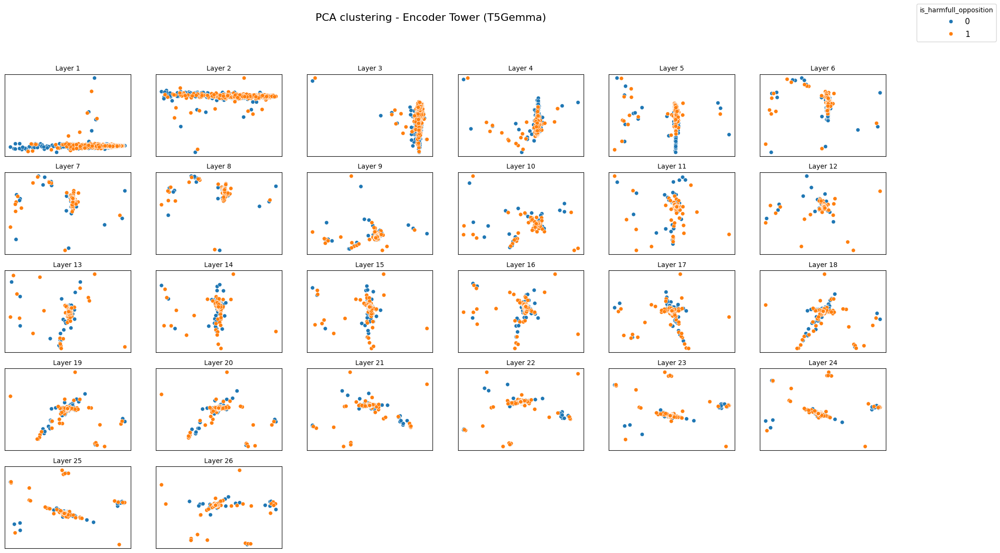

In [ ]:
import torch
import pandas as pd
import numpy as np
from extract_fixed_t5gemma import vectorize_df
from format_results_fixed import plot_pca_or_tsne_layerwise


# ──────────────────────────────────────────────────────────────────────────────
# 2. Load your datasets
# ──────────────────────────────────────────────────────────────────────────────

hate_data           = pd.read_csv('../data/raw/total_hate_data.csv', index_col=0)
hate_total_yes_data = pd.read_csv('../data/yes_no/hate_total_yes_data.csv', index_col=0)
hate_total_no_data  = pd.read_csv('../data/yes_no/hate_total_no_data.csv',  index_col=0)

# ──────────────────────────────────────────────────────────────────────────────
# 3. Helper to run vectorise‑>save‑>normalise in one go
# ──────────────────────────────────────────────────────────────────────────────
def embed_and_normalise(df_text, tower_tag, strategy, use_decoder, model, tokenizer):
    """Returns L2‑normalised (n_samples, n_layers, dim) GPU tensor"""
    # CHANGED: Use GPU device and return GPU tensor
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    
    X = vectorize_df(df_text,
                     model, tokenizer,
                     strategy=strategy, 
                     model_type="encoder-decoder",
                     use_decoder=use_decoder,
                     get_all_hs=True,
                     device=device)  # CHANGED: Use GPU

    # CHANGED: Save CPU version but keep GPU tensor for return
    np.savez_compressed(f"{YOUR_NAME}_{tower_tag}_{strategy}.npz", X.cpu().numpy())

    # CHANGED: L2-normalize on GPU
    X_flat = X.view(-1, X.shape[-1])
    X_norm = torch.nn.functional.normalize(X_flat, p=2, dim=1).view(X.shape)

    # CHANGED: Save normalized version
    # np.savez_compressed(f"{YOUR_NAME}_{tower_tag}_{strategy}_norm.npz", X_norm.cpu().numpy())
    return X_norm  # CHANGED: Return GPU tensor

# ──────────────────────────────────────────────────────────────────────────────
# 4‑A. Encoder tower  (mean token works best)
# ──────────────────────────────────────────────────────────────────────────────
print("\n► Extracting *encoder* embeddings …")
X_pos_enc = embed_and_normalise(hate_total_yes_data['statement'],
                                tower_tag="enc_pos",
                                strategy="first-token",
                                use_decoder=False,
                                model=model,
                                tokenizer=tokenizer)

X_neg_enc = embed_and_normalise(hate_total_no_data['statement'],
                                tower_tag="enc_neg",
                                strategy="first-token",
                                use_decoder=False,
                                model=model,
                                tokenizer=tokenizer)

# CHANGED: Convert GPU tensors to CPU numpy arrays for plotting
X_pos_enc = X_pos_enc.cpu().numpy()
X_neg_enc = X_neg_enc.cpu().numpy()

print("\n► Plotting PCA for *encoder* embeddings …")
plot_pca_or_tsne_layerwise(X_pos_enc,
                           X_neg_enc,
                           hate_data['is_harmfull_opposition'],
                           standardize=False, n_components=5,
                           components=[0, 1], mode='pca',
                           plot_title='PCA clustering - Encoder Tower (T5Gemma)')





► Extracting *encoder* embeddings …


Extracting embeddings (strategy: last-token): 100%|██████████| 1244/1244 [09:49<00:00,  2.11it/s]


Extraction completed: shape=torch.Size([1244, 27, 2304]), dtype=torch.float32, device=cpu
Stats: max=135.000, min=-294.000, std=3.847


Extracting embeddings (strategy: last-token): 100%|██████████| 1244/1244 [09:25<00:00,  2.20it/s]


Extraction completed: shape=torch.Size([1244, 27, 2304]), dtype=torch.float32, device=cpu
Stats: max=119.000, min=-206.000, std=3.671

► Plotting PCA for *encoder* embeddings …


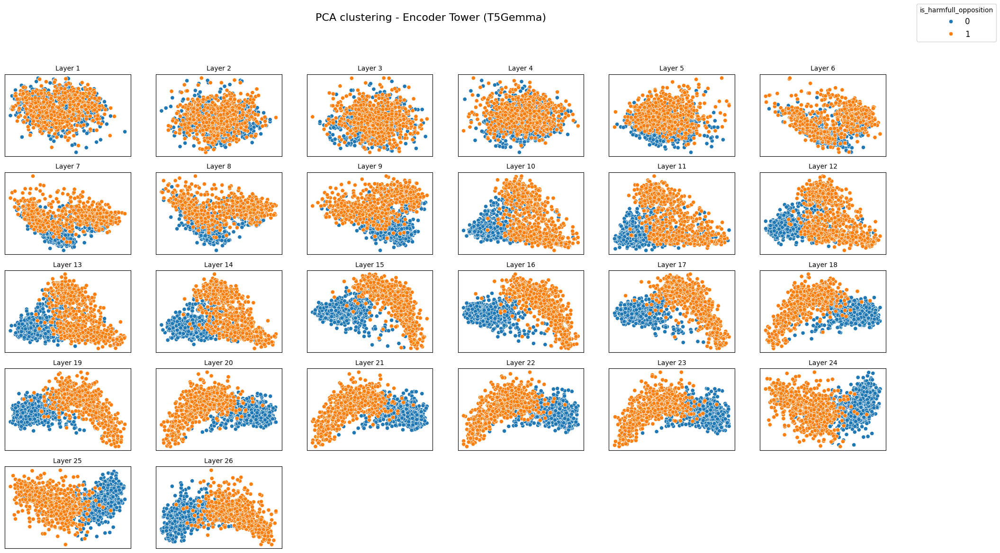

In [ ]:
# ──────────────────────────────────────────────────────────────────────────────
# 4‑A. Encoder tower  (mean token works best)
# ──────────────────────────────────────────────────────────────────────────────
print("\n► Extracting *encoder* embeddings …")
X_pos_enc = embed_and_normalise(hate_total_yes_data['statement'],
                                tower_tag="enc_pos",
                                strategy="last-token",
                                use_decoder=False,
                                model=model,
                                tokenizer=tokenizer)

X_neg_enc = embed_and_normalise(hate_total_no_data['statement'],
                                tower_tag="enc_neg",
                                strategy="last-token",
                                use_decoder=False,
                                model=model,
                                tokenizer=tokenizer)

# CHANGED: Convert GPU tensors to CPU numpy arrays for plotting
X_pos_enc = X_pos_enc.cpu().numpy()
X_neg_enc = X_neg_enc.cpu().numpy()

print("\n► Plotting PCA for *encoder* embeddings …")
plot_pca_or_tsne_layerwise(X_pos_enc,
                           X_neg_enc,
                           hate_data['is_harmfull_opposition'],
                           standardize=False, n_components=5,
                           components=[0, 1], mode='pca',
                           plot_title='PCA clustering - Encoder Tower (T5Gemma)')


► Extracting *encoder* embeddings …


Extracting embeddings (strategy: mean): 100%|██████████| 1244/1244 [07:55<00:00,  2.62it/s]


Extraction completed: shape=torch.Size([1244, 27, 2304]), dtype=torch.float32, device=cpu
Stats: max=234.339, min=-552.714, std=3.269


Extracting embeddings (strategy: mean): 100%|██████████| 1244/1244 [08:13<00:00,  2.52it/s]


Extraction completed: shape=torch.Size([1244, 27, 2304]), dtype=torch.float32, device=cpu
Stats: max=239.022, min=-539.214, std=3.224

► Plotting PCA for *encoder* embeddings …


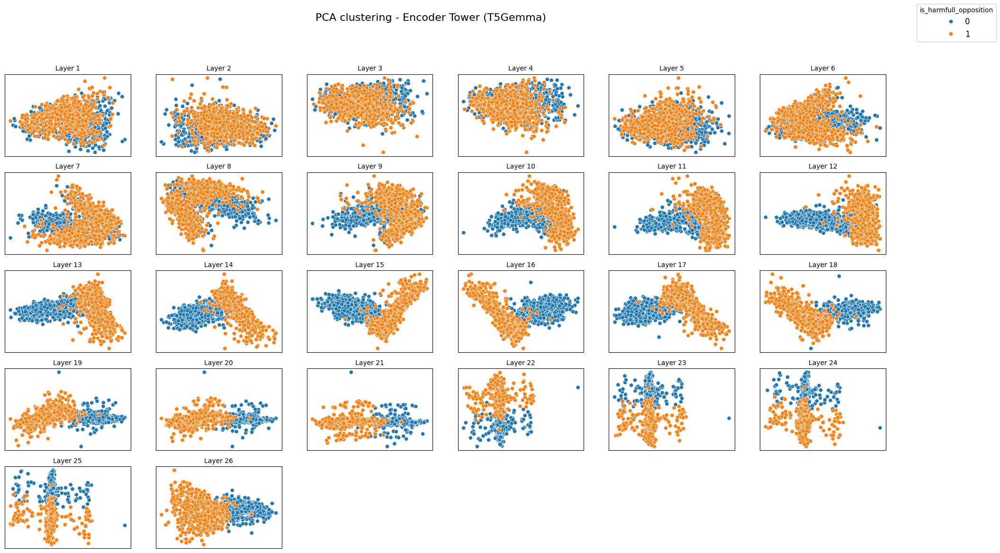

In [7]:
# ──────────────────────────────────────────────────────────────────────────────
# 4‑A. Encoder tower  (mean token works best)
# ──────────────────────────────────────────────────────────────────────────────
print("\n► Extracting *encoder* embeddings …")
X_pos_enc = embed_and_normalise(hate_total_yes_data['statement'],
                                tower_tag="enc_pos",
                                strategy="mean",
                                use_decoder=False,
                                model=model,
                                tokenizer=tokenizer)

X_neg_enc = embed_and_normalise(hate_total_no_data['statement'],
                                tower_tag="enc_neg",
                                strategy="mean",
                                use_decoder=False,
                                model=model,
                                tokenizer=tokenizer)

# CHANGED: Convert GPU tensors to CPU numpy arrays for plotting
X_pos_enc = X_pos_enc.cpu().numpy()
X_neg_enc = X_neg_enc.cpu().numpy()

print("\n► Plotting PCA for *encoder* embeddings …")
plot_pca_or_tsne_layerwise(X_pos_enc,
                           X_neg_enc,
                           hate_data['is_harmfull_opposition'],
                           standardize=False, n_components=5,
                           components=[0, 1], mode='pca',
                           plot_title='PCA clustering - Encoder Tower (T5Gemma)')

Added /Users/elenaericheva/ericheva_git/ccs_aisf/code to Python path

► Plotting PCA for *encoder* embeddings …


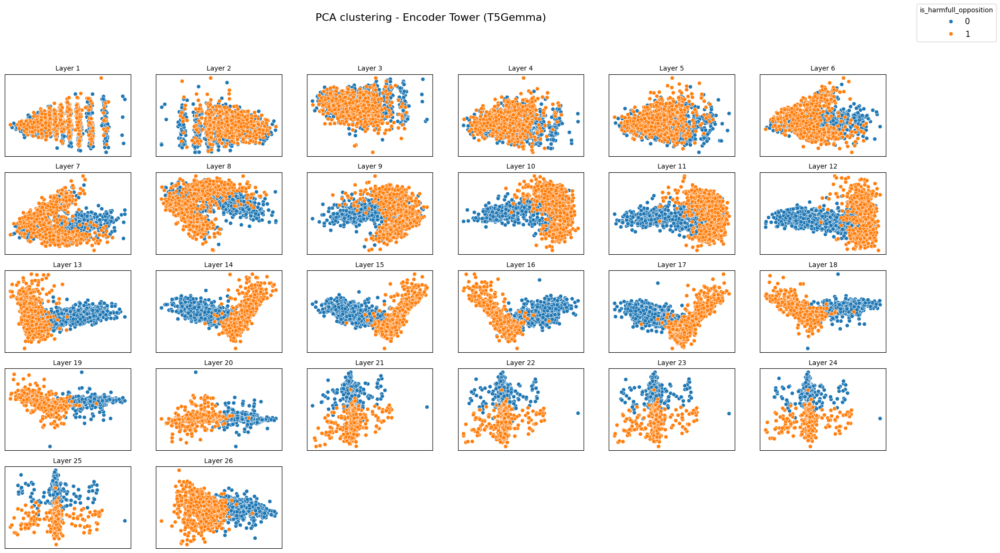

In [2]:
# recheck for env_mean
#######
#######
#######
import sys
import os

# Add the code directory directly to Python path
code_dir = '/Users/elenaericheva/ericheva_git/ccs_aisf/code'
if code_dir not in sys.path:
    sys.path.insert(0, code_dir)

print(f"Added {code_dir} to Python path")

import numpy as np
import pandas as pd
from format_results_fixed import plot_pca_or_tsne_layerwise

YOUR_NAME = "t5gemma-2b-2b-ul2-it"
strategy = "mean"
hate_data = pd.read_csv('../data/raw/total_hate_data.csv', index_col=0)
X_pos_enc = np.load(f"{YOUR_NAME}_enc_pos_{strategy}.npz")['arr_0']
X_neg_enc = np.load(f"{YOUR_NAME}_enc_neg_{strategy}.npz")['arr_0']

print("\n► Plotting PCA for *encoder* embeddings …")
plot_pca_or_tsne_layerwise(X_pos_enc,
                           X_neg_enc,
                           hate_data['is_harmfull_opposition'],
                           standardize=False, n_components=5,
                           components=[0, 1], mode='pca',
                           plot_title='PCA clustering - Encoder Tower (T5Gemma)')

#######
#######
#######


► Extracting *decoder* embeddings …


Extracting embeddings (strategy: first-token): 100%|██████████| 1244/1244 [17:16<00:00,  1.20it/s]


Extraction completed: shape=torch.Size([1244, 27, 2304]), dtype=torch.float32, device=cpu
Stats: max=948.000, min=-412.000, std=15.912


Extracting embeddings (strategy: first-token): 100%|██████████| 1244/1244 [16:12<00:00,  1.28it/s]


Extraction completed: shape=torch.Size([1244, 27, 2304]), dtype=torch.float32, device=cpu
Stats: max=948.000, min=-408.000, std=15.916

► Plotting PCA for *encoder* embeddings …


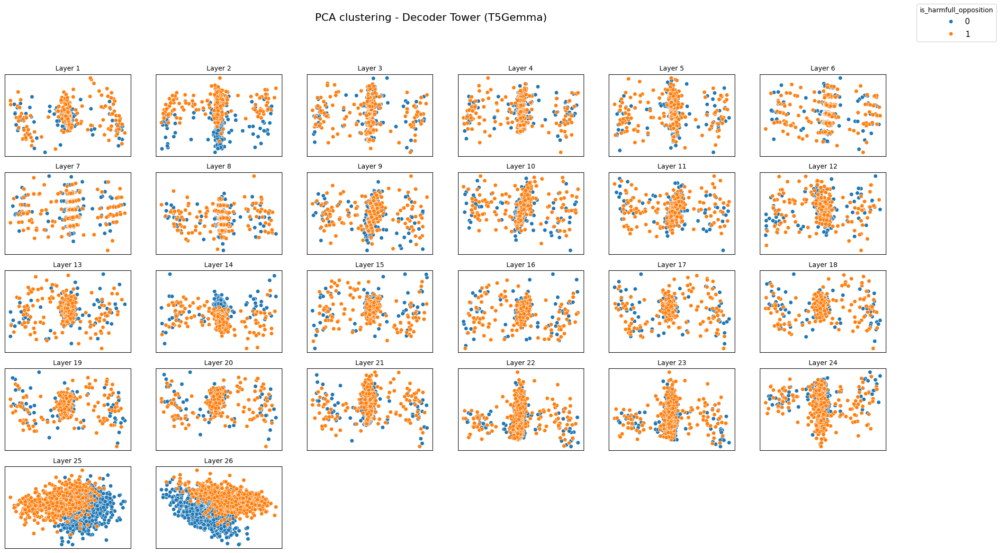

In [ ]:
# ──────────────────────────────────────────────────────────────────────────────
# 4‑B. Decoder tower  (last token works best)
# ──────────────────────────────────────────────────────────────────────────────
print("\n► Extracting *decoder* embeddings …")
X_pos_dec = embed_and_normalise(hate_total_yes_data['statement'],
                                tower_tag="dec_pos",
                                strategy="first-token",
                                use_decoder=True,
                                model=model,
                                tokenizer=tokenizer)

X_neg_dec = embed_and_normalise(hate_total_no_data['statement'],
                                tower_tag="dec_neg",
                                strategy="first-token",
                                use_decoder=True,
                                model=model,
                                tokenizer=tokenizer)

# CHANGED: Convert GPU tensors to CPU numpy arrays for plotting
X_pos_dec = X_pos_dec.cpu().numpy()
X_neg_dec = X_neg_dec.cpu().numpy()

print("\n► Plotting PCA for *encoder* embeddings …")
plot_pca_or_tsne_layerwise(X_pos_dec,
                           X_neg_dec,
                           hate_data['is_harmfull_opposition'],
                           standardize=False, n_components=5,
                           components=[0, 1], mode='pca',
                           plot_title='PCA clustering - Decoder Tower (T5Gemma)')


► Extracting *encoder* embeddings …


Extracting embeddings (strategy: mean): 100%|██████████| 1244/1244 [15:40<00:00,  1.32it/s]


Extraction completed: shape=torch.Size([1244, 27, 2304]), dtype=torch.float32, device=cpu
Stats: max=165.151, min=-120.591, std=2.573


Extracting embeddings (strategy: mean): 100%|██████████| 1244/1244 [18:51<00:00,  1.10it/s]


Extraction completed: shape=torch.Size([1244, 27, 2304]), dtype=torch.float32, device=cpu
Stats: max=167.688, min=-115.591, std=2.568

► Plotting PCA for *encoder* embeddings …


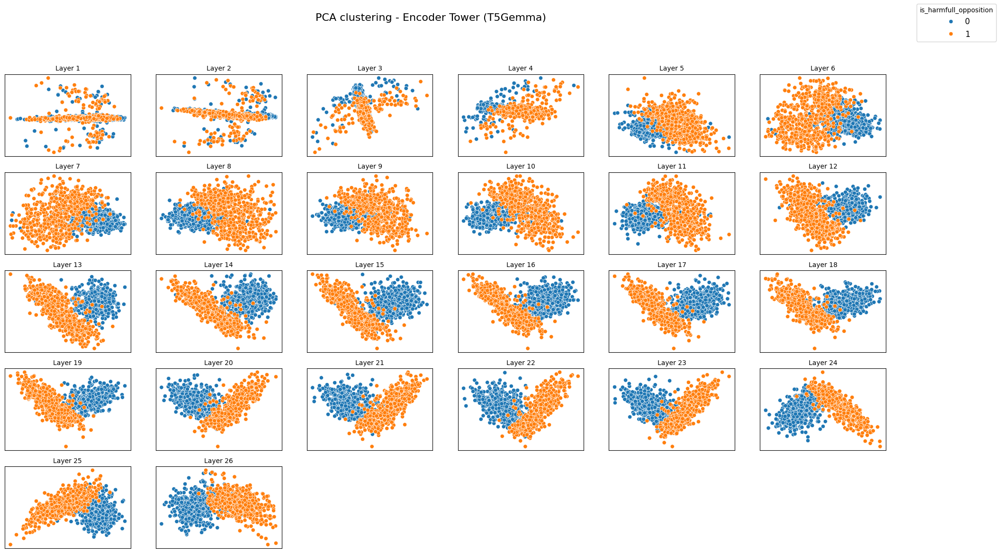

In [9]:
# ──────────────────────────────────────────────────────────────────────────────
# 4‑B. Decoder tower  (last token works best)
# ──────────────────────────────────────────────────────────────────────────────
print("\n► Extracting *encoder* embeddings …")
X_pos_dec = embed_and_normalise(hate_total_yes_data['statement'],
                                tower_tag="dec_pos",
                                strategy="mean",
                                use_decoder=True,
                                model=model,
                                tokenizer=tokenizer)

X_neg_dec = embed_and_normalise(hate_total_no_data['statement'],
                                tower_tag="dec_neg",
                                strategy="mean",
                                use_decoder=True,
                                model=model,
                                tokenizer=tokenizer)

# CHANGED: Convert GPU tensors to CPU numpy arrays for plotting
X_pos_dec = X_pos_dec.cpu().numpy()
X_neg_dec = X_neg_dec.cpu().numpy()

print("\n► Plotting PCA for *encoder* embeddings …")
plot_pca_or_tsne_layerwise(X_pos_dec,
                           X_neg_dec,
                           hate_data['is_harmfull_opposition'],
                           standardize=False, n_components=5,
                           components=[0, 1], mode='pca',
                           plot_title='PCA clustering - Encoder Tower (T5Gemma)')


► Extracting *encoder* embeddings …


Extracting embeddings (strategy: last-token): 100%|██████████| 1244/1244 [17:02<00:00,  1.22it/s]


Extraction completed: shape=torch.Size([1244, 27, 2304]), dtype=torch.float32, device=cpu
Stats: max=76.000, min=-148.000, std=3.332


Extracting embeddings (strategy: last-token): 100%|██████████| 1244/1244 [15:23<00:00,  1.35it/s]


Extraction completed: shape=torch.Size([1244, 27, 2304]), dtype=torch.float32, device=cpu
Stats: max=75.000, min=-139.000, std=3.334

► Plotting PCA for *encoder* embeddings …


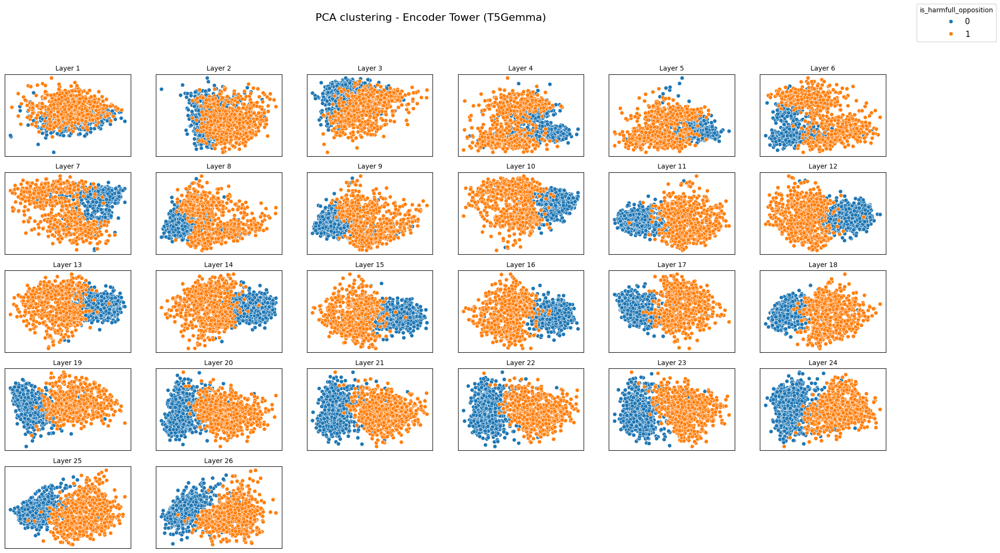

In [12]:
# ──────────────────────────────────────────────────────────────────────────────
# 4‑B. Decoder tower  (last token works best)
# ──────────────────────────────────────────────────────────────────────────────
print("\n► Extracting *encoder* embeddings …")
X_pos_dec = embed_and_normalise(hate_total_yes_data['statement'],
                                tower_tag="dec_pos",
                                strategy="last-token",
                                use_decoder=True,
                                model=model,
                                tokenizer=tokenizer)

X_neg_dec = embed_and_normalise(hate_total_no_data['statement'],
                                tower_tag="dec_neg",
                                strategy="last-token",
                                use_decoder=True,
                                model=model,
                                tokenizer=tokenizer)

# CHANGED: Convert GPU tensors to CPU numpy arrays for plotting
X_pos_dec = X_pos_dec.cpu().numpy()
X_neg_dec = X_neg_dec.cpu().numpy()

print("\n► Plotting PCA for *encoder* embeddings …")
plot_pca_or_tsne_layerwise(X_pos_dec,
                           X_neg_dec,
                           hate_data['is_harmfull_opposition'],
                           standardize=False, n_components=5,
                           components=[0, 1], mode='pca',
                           plot_title='PCA clustering - Encoder Tower (T5Gemma)')

Added /Users/elenaericheva/ericheva_git/ccs_aisf/code to Python path

► Plotting PCA for *encoder* embeddings …


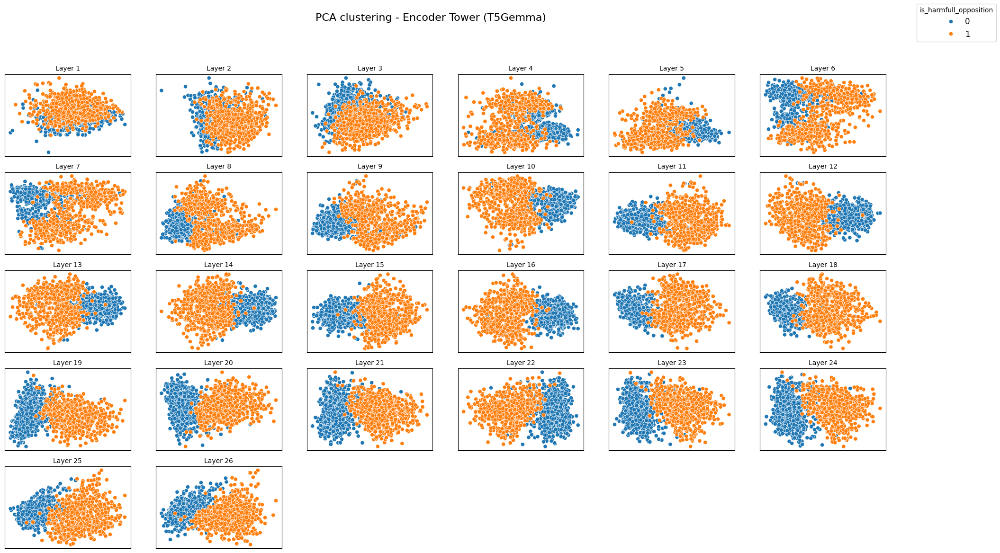

In [3]:
# recheck for dec_last-token
#######
#######
#######
import sys
import os

# Add the code directory directly to Python path
code_dir = '/Users/elenaericheva/ericheva_git/ccs_aisf/code'
if code_dir not in sys.path:
    sys.path.insert(0, code_dir)

print(f"Added {code_dir} to Python path")

import numpy as np
import pandas as pd
from format_results_fixed import plot_pca_or_tsne_layerwise

YOUR_NAME = "t5gemma-2b-2b-ul2-it"
strategy = "last-token"
hate_data = pd.read_csv('../data/raw/total_hate_data.csv', index_col=0)
X_pos_dec = np.load(f"{YOUR_NAME}_dec_pos_{strategy}.npz")['arr_0']
X_neg_dec = np.load(f"{YOUR_NAME}_dec_neg_{strategy}.npz")['arr_0']

print("\n► Plotting PCA for *encoder* embeddings …")
plot_pca_or_tsne_layerwise(X_pos_dec,
                           X_neg_dec,
                           hate_data['is_harmfull_opposition'],
                           standardize=False, n_components=5,
                           components=[0, 1], mode='pca',
                           plot_title='PCA clustering - Encoder Tower (T5Gemma)')

#######
#######
#######

## **5. Find best CCS**


To find the best layers, train CCS on all hidden states. You can use different normalization strategies, the best in experiments was l2 + median.

In [1]:
import sys
import os

# Add the code directory directly to Python path
code_dir = '/Users/elenaericheva/ericheva_git/ccs_aisf/code'
if code_dir not in sys.path:
    sys.path.insert(0, code_dir)

print(f"Added {code_dir} to Python path")

import random, numpy as np, torch, pickle, matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from ccs import train_ccs_on_hidden_states
import pandas as pd

SEED = 42
random.seed(SEED); np.random.seed(SEED); torch.manual_seed(SEED)
torch.backends.cudnn.deterministic, torch.backends.cudnn.benchmark = True, False

def run_ccs(X_pos_norm, X_neg_norm, *, tower_tag):
    # Train / test split once per tower
    idx              = np.arange(len(X_pos_norm))
    train_idx, test_idx = train_test_split(idx, test_size=0.2,
                                           random_state=71, shuffle=True)

    # CCS
    ccs_layers = train_ccs_on_hidden_states(X_pos_norm,
                                            X_neg_norm,
                                            hate_data['is_harmfull_opposition'],
                                            train_idx, test_idx,
                                            normalizing='median')

    # save
    with open(f'ccs_{YOUR_NAME}_{tower_tag}_mixed_results.pkl', 'wb') as f:
        pickle.dump(ccs_layers, f)

    # Accuracy curve
    acc = [layer_data['accuracy'] for layer_idx, layer_data in ccs_layers.items()]
    plt.figure(); plt.plot(acc); plt.title(f'CCS accuracy per layer ({tower_tag})')
    plt.xlabel('Layer'); plt.ylabel('Accuracy'); plt.show()

    # Best layer
    best_layer = int(np.argmax(acc))
    print(f'► Best {tower_tag} layer = {best_layer}  (acc={acc[best_layer]:.3f})')
    return best_layer

# best_enc_layer = run_ccs(X_pos_enc, X_neg_enc, tower_tag='enc')


Added /Users/elenaericheva/ericheva_git/ccs_aisf/code to Python path


Median normalize used
Layer 1/27, CCS accuracy: 0.5381526104417671
Median normalize used
Layer 2/27, CCS accuracy: 0.5301204819277109
Median normalize used
Layer 3/27, CCS accuracy: 0.5180722891566265
Median normalize used
Layer 4/27, CCS accuracy: 0.5180722891566265
Median normalize used
Layer 5/27, CCS accuracy: 0.5502008032128514
Median normalize used
Layer 6/27, CCS accuracy: 0.5542168674698795
Median normalize used
Layer 7/27, CCS accuracy: 0.5060240963855421
Median normalize used
Layer 8/27, CCS accuracy: 0.5261044176706827
Median normalize used
Layer 9/27, CCS accuracy: 0.5582329317269077
Median normalize used
Layer 10/27, CCS accuracy: 0.5180722891566265
Median normalize used
Layer 11/27, CCS accuracy: 0.5020080321285141
Median normalize used
Layer 12/27, CCS accuracy: 0.5983935742971888
Median normalize used
Layer 13/27, CCS accuracy: 0.570281124497992
Median normalize used
Layer 14/27, CCS accuracy: 0.5582329317269076
Median normalize used
Layer 15/27, CCS accuracy: 0.5020080

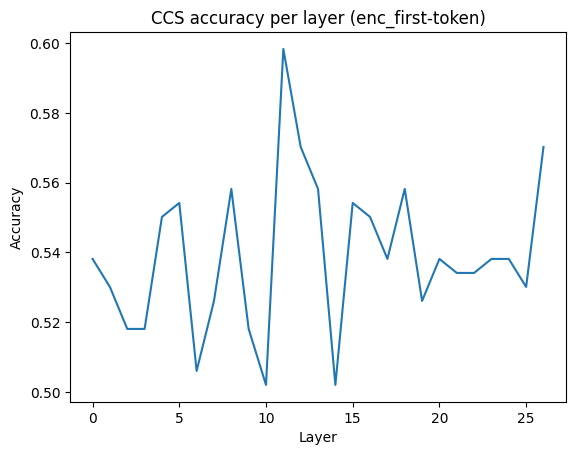

► Best enc_first-token layer = 11  (acc=0.598)


In [2]:
YOUR_NAME = "t5gemma-2b-2b-ul2"
strategy = "first-token"
hate_data = pd.read_csv('../data/raw/total_hate_data.csv', index_col=0)
X_pos_enc = np.load(f"{YOUR_NAME}_enc_pos_{strategy}.npz")['arr_0']
X_neg_enc = np.load(f"{YOUR_NAME}_enc_neg_{strategy}.npz")['arr_0']
best_enc_layer = run_ccs(X_pos_enc, X_neg_enc, tower_tag=f'enc_{strategy}')

Median normalize used
Layer 1/27, CCS accuracy: 0.5381526104417671
Median normalize used
Layer 2/27, CCS accuracy: 0.5903614457831325
Median normalize used
Layer 3/27, CCS accuracy: 0.6305220883534136
Median normalize used
Layer 4/27, CCS accuracy: 0.6104417670682731
Median normalize used
Layer 5/27, CCS accuracy: 0.5502008032128514
Median normalize used
Layer 6/27, CCS accuracy: 0.642570281124498
Median normalize used
Layer 7/27, CCS accuracy: 0.6666666666666667
Median normalize used
Layer 8/27, CCS accuracy: 0.6706827309236948
Median normalize used
Layer 9/27, CCS accuracy: 0.6586345381526104
Median normalize used
Layer 10/27, CCS accuracy: 0.6666666666666666
Median normalize used
Layer 11/27, CCS accuracy: 0.6746987951807228
Median normalize used
Layer 12/27, CCS accuracy: 0.6706827309236948
Median normalize used
Layer 13/27, CCS accuracy: 0.678714859437751
Median normalize used
Layer 14/27, CCS accuracy: 0.6666666666666666
Median normalize used
Layer 15/27, CCS accuracy: 0.74698795

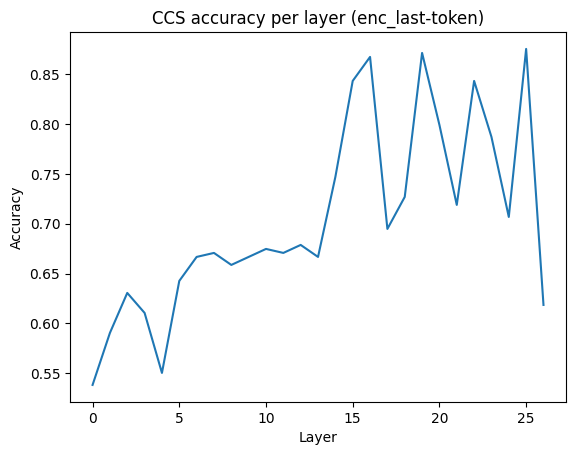

► Best enc_last-token layer = 25  (acc=0.876)


In [3]:
YOUR_NAME = "t5gemma-2b-2b-ul2"
strategy = "last-token"
hate_data = pd.read_csv('../data/raw/total_hate_data.csv', index_col=0)
X_pos_enc = np.load(f"{YOUR_NAME}_enc_pos_{strategy}.npz")['arr_0']
X_neg_enc = np.load(f"{YOUR_NAME}_enc_neg_{strategy}.npz")['arr_0']
best_enc_layer = run_ccs(X_pos_enc, X_neg_enc, tower_tag=f'enc_{strategy}')

In [ ]:
YOUR_NAME = "t5gemma-2b-2b-ul2-it"
strategy = "first-token"
hate_data = pd.read_csv('../data/raw/total_hate_data.csv', index_col=0)
X_pos_dec = np.load(f"{YOUR_NAME}_dec_pos_{strategy}.npz")['arr_0']
X_neg_dec = np.load(f"{YOUR_NAME}_dec_neg_{strategy}.npz")['arr_0']
best_dec_layer = run_ccs(X_pos_dec, X_neg_dec, tower_tag=f'dec_{strategy}')

Median normalize used
Layer 1/27, CCS accuracy: 0.5381526104417671
Median normalize used
Layer 2/27, CCS accuracy: 0.5461847389558233
Median normalize used
Layer 3/27, CCS accuracy: 0.8755020080321285
Median normalize used
Layer 4/27, CCS accuracy: 0.8795180722891567
Median normalize used
Layer 5/27, CCS accuracy: 0.8554216867469879
Median normalize used
Layer 6/27, CCS accuracy: 0.891566265060241
Median normalize used


In [ ]:
YOUR_NAME = "t5gemma-2b-2b-ul2-it"
strategy = "mean"
hate_data = pd.read_csv('../data/raw/total_hate_data.csv', index_col=0)
X_pos_dec = np.load(f"{YOUR_NAME}_dec_pos_{strategy}.npz")['arr_0']
X_neg_dec = np.load(f"{YOUR_NAME}_dec_neg_{strategy}.npz")['arr_0']
best_dec_layer = run_ccs(X_pos_dec, X_neg_dec, tower_tag=f'dec_{strategy}')

Median normalize used
Layer 1/27, CCS accuracy: 0.5823293172690763
Median normalize used
Layer 2/27, CCS accuracy: 0.5823293172690763
Median normalize used
Layer 3/27, CCS accuracy: 0.6024096385542169
Median normalize used
Layer 4/27, CCS accuracy: 0.5903614457831325
Median normalize used
Layer 5/27, CCS accuracy: 0.5823293172690763
Median normalize used
Layer 6/27, CCS accuracy: 0.5903614457831325
Median normalize used
Layer 7/27, CCS accuracy: 0.5943775100401607
Median normalize used
Layer 8/27, CCS accuracy: 0.6104417670682731
Median normalize used
Layer 9/27, CCS accuracy: 0.6184738955823292
Median normalize used
Layer 10/27, CCS accuracy: 0.6104417670682731
Median normalize used
Layer 11/27, CCS accuracy: 0.6706827309236948
Median normalize used
Layer 12/27, CCS accuracy: 0.7831325301204819
Median normalize used
Layer 13/27, CCS accuracy: 0.8353413654618473
Median normalize used
Layer 14/27, CCS accuracy: 0.8152610441767069
Median normalize used
Layer 15/27, CCS accuracy: 0.891566

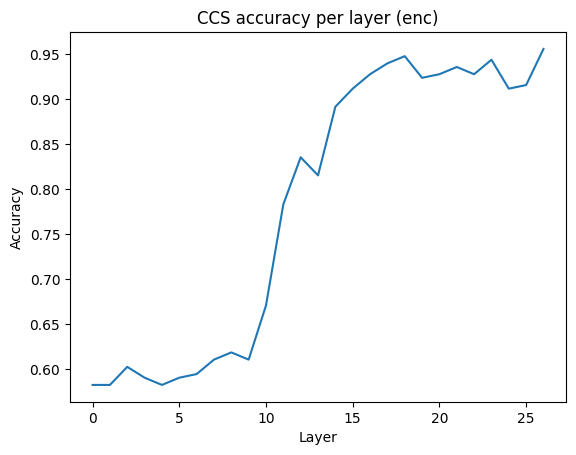

► Best enc layer = 26  (acc=0.956)


In [ ]:
# !!!!!!!!!!!!
YOUR_NAME = "t5gemma-2b-2b-ul2-it"
strategy = "mean"
hate_data = pd.read_csv('../data/raw/total_hate_data.csv', index_col=0)
X_pos_dec = np.load(f"{YOUR_NAME}_dec_pos_{strategy}.npz")['arr_0']
X_neg_dec = np.load(f"{YOUR_NAME}_dec_neg_{strategy}.npz")['arr_0']
best_dec_layer = run_ccs(X_pos_dec, X_neg_dec, tower_tag=f'dec_{strategy}')

After that, we train the CCS on the selected layer to obtain the probe and its weights.

Median normalize used
Layer 1/27, CCS accuracy: 0.5381526104417671
Median normalize used
Layer 2/27, CCS accuracy: 0.5261044176706827
Median normalize used
Layer 3/27, CCS accuracy: 0.6987951807228916
Median normalize used
Layer 4/27, CCS accuracy: 0.7469879518072289
Median normalize used
Layer 5/27, CCS accuracy: 0.6345381526104418
Median normalize used
Layer 6/27, CCS accuracy: 0.9076305220883534
Median normalize used
Layer 7/27, CCS accuracy: 0.6465863453815262
Median normalize used
Layer 8/27, CCS accuracy: 0.6345381526104418
Median normalize used
Layer 9/27, CCS accuracy: 0.6506024096385542
Median normalize used
Layer 10/27, CCS accuracy: 0.9397590361445783
Median normalize used
Layer 11/27, CCS accuracy: 0.9437751004016064
Median normalize used
Layer 12/27, CCS accuracy: 0.9437751004016064
Median normalize used
Layer 13/27, CCS accuracy: 0.963855421686747
Median normalize used
Layer 14/27, CCS accuracy: 0.9759036144578314
Median normalize used
Layer 15/27, CCS accuracy: 0.9718875

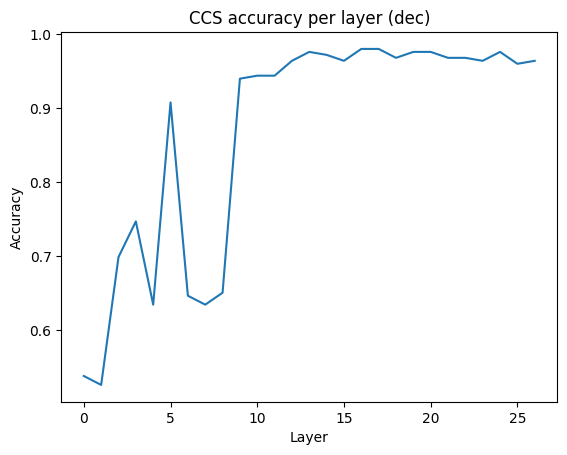

► Best dec layer = 16  (acc=0.980)


In [ ]:
# !!!!!!!!!!
YOUR_NAME = "t5gemma-2b-2b-ul2-it"
strategy = "last-token"
hate_data = pd.read_csv('../data/raw/total_hate_data.csv', index_col=0)
X_pos_dec = np.load(f"{YOUR_NAME}_dec_pos_{strategy}.npz")['arr_0']
X_neg_dec = np.load(f"{YOUR_NAME}_dec_neg_{strategy}.npz")['arr_0']
best_dec_layer = run_ccs(X_pos_dec, X_neg_dec, tower_tag=f'dec_{strategy}')


In [ ]:
1/0

In [ ]:
from ccs import CCS
import pandas as pd, numpy as np, pickle
from sklearn.model_selection import train_test_split

def single_layer_ccs(X_pos_norm, X_neg_norm, best_layer, *, tower_tag):
    # Slice out the chosen layer
    X_pos_layer = pd.DataFrame(X_pos_norm[:, best_layer])
    X_neg_layer = pd.DataFrame(X_neg_norm[:, best_layer])

    idx = np.arange(len(X_pos_norm))
    train_idx, test_idx = train_test_split(idx, test_size=0.2,
                                           random_state=71, shuffle=True)

    # Train/test split
    X_pos_train = X_pos_layer.loc[train_idx].values.astype(np.float32)
    X_pos_test  = X_pos_layer.loc[test_idx].values.astype(np.float32)
    X_neg_train = X_neg_layer.loc[train_idx].values.astype(np.float32)
    X_neg_test  = X_neg_layer.loc[test_idx].values.astype(np.float32)

    y_train = hate_data['is_harmfull_opposition'][train_idx]
    y_test  = hate_data['is_harmfull_opposition'][test_idx]

    # Median normalise in‑place
    X_pos_train -= np.median(X_pos_train); X_pos_test -= np.median(X_pos_train)
    X_neg_train -= np.median(X_neg_train); X_neg_test -= np.median(X_neg_train)

    # CCS without labels (NEG first, then POS)
    ccs = CCS(X_neg_train, X_pos_train, y_train.values,
              var_normalize=False, lambda_classification=0,
              predict_normalize=False)
    ccs.repeated_train()

    acc = ccs.get_acc(X_neg_test, X_pos_test, y_test.values)
    print(f'CCS accuracy ({tower_tag}, layer {best_layer}) = {acc:.3f}')

    with open(f'ccs_{YOUR_NAME}_{tower_tag}_mixed_l{best_layer}.pkl', 'wb') as f:
        pickle.dump(ccs, f)

# Run for both towers
hate_data = pd.read_csv('../data/raw/total_hate_data.csv', index_col=0)
strategy = "mean"
X_pos_enc = np.load(f"{YOUR_NAME}_enc_pos_{strategy}.npz")['arr_0']
X_neg_enc = np.load(f"{YOUR_NAME}_enc_neg_{strategy}.npz")['arr_0']
single_layer_ccs(X_pos_enc, X_neg_enc, best_enc_layer, tower_tag=f'enc_{strategy}')
strategy = "first-token"
X_pos_enc = np.load(f"{YOUR_NAME}_enc_pos_{strategy}.npz")['arr_0']
X_neg_enc = np.load(f"{YOUR_NAME}_enc_neg_{strategy}.npz")['arr_0']
single_layer_ccs(X_pos_enc, X_neg_enc, best_enc_layer, tower_tag=f'enc_{strategy}')

best_enc_layer = 26
strategy = "last-token"
X_pos_enc = np.load(f"{YOUR_NAME}_enc_pos_{strategy}.npz")['arr_0']
X_neg_enc = np.load(f"{YOUR_NAME}_enc_neg_{strategy}.npz")['arr_0']
single_layer_ccs(X_pos_enc, X_neg_enc, best_enc_layer, tower_tag=f'enc_{strategy}!!!!')

print("")
strategy = "first-token"
X_pos_dec = np.load(f"{YOUR_NAME}_dec_pos_{strategy}.npz")['arr_0']
X_neg_dec = np.load(f"{YOUR_NAME}_dec_neg_{strategy}.npz")['arr_0']
single_layer_ccs(X_pos_dec, X_neg_dec, best_dec_layer, tower_tag=f'dec_{strategy}')
strategy = "mean"
X_pos_dec = np.load(f"{YOUR_NAME}_dec_pos_{strategy}.npz")['arr_0']
X_neg_dec = np.load(f"{YOUR_NAME}_dec_neg_{strategy}.npz")['arr_0']
single_layer_ccs(X_pos_dec, X_neg_dec, best_dec_layer, tower_tag=f'dec_{strategy}')

best_dec_layer = 16
strategy = "last-token"
X_pos_dec = np.load(f"{YOUR_NAME}_dec_pos_{strategy}.npz")['arr_0']
X_neg_dec = np.load(f"{YOUR_NAME}_dec_neg_{strategy}.npz")['arr_0']
single_layer_ccs(X_pos_dec, X_neg_dec, best_dec_layer, tower_tag=f'dec_{strategy}!!!!')


CCS accuracy (enc, layer 20) = 0.912
CCS accuracy (dec, layer 23) = 0.972


# NOT

In [8]:
import torch
import pandas as pd
import numpy as np
from extract_fixed_t5gemma import vectorize_df
from format_results_fixed import plot_pca_or_tsne_layerwise


# ──────────────────────────────────────────────────────────────────────────────
# 2. Load your datasets
# ──────────────────────────────────────────────────────────────────────────────

hate_data           = pd.read_csv('../data/raw/total_hate3.0.csv', index_col=0)
hate_total_yes_data = pd.read_csv('../data/yes_no/hate_total3.0_yes.csv', index_col=0)
hate_total_no_data  = pd.read_csv('../data/yes_no/hate_total3.0_no.csv',  index_col=0)

# ──────────────────────────────────────────────────────────────────────────────
# 3. Helper to run vectorise‑>save‑>normalise in one go
# ──────────────────────────────────────────────────────────────────────────────
def embed_and_normalise(df_text, tower_tag, strategy, use_decoder, model, tokenizer):
    """Returns L2‑normalised (n_samples, n_layers, dim) GPU tensor"""
    # CHANGED: Use GPU device and return GPU tensor
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    
    X = vectorize_df(df_text,
                     model, tokenizer,
                     strategy=strategy, 
                     model_type="encoder-decoder",
                     use_decoder=use_decoder,
                     get_all_hs=True,
                     device=device)  # CHANGED: Use GPU

    # CHANGED: Save CPU version but keep GPU tensor for return
    np.savez_compressed(f"{YOUR_NAME}_{tower_tag}_{strategy}_not.npz", X.cpu().numpy())

    # CHANGED: L2-normalize on GPU
    X_flat = X.view(-1, X.shape[-1])
    X_norm = torch.nn.functional.normalize(X_flat, p=2, dim=1).view(X.shape)

    # CHANGED: Save normalized version
    # np.savez_compressed(f"{YOUR_NAME}_{tower_tag}_{strategy}_norm.npz", X_norm.cpu().numpy())
    return X_norm  # CHANGED: Return GPU tensor

# 


In [ ]:
──────────────────────────────────────────────────────────────────────────────
# 4‑A. Encoder tower  (mean token works best)
# ──────────────────────────────────────────────────────────────────────────────
print("\n► Extracting *encoder* embeddings …")
X_pos_enc = embed_and_normalise(hate_total_yes_data['statement'],
                                tower_tag="enc_pos",
                                strategy="first-token",
                                use_decoder=False,
                                model=model,
                                tokenizer=tokenizer)

X_neg_enc = embed_and_normalise(hate_total_no_data['statement'],
                                tower_tag="enc_neg",
                                strategy="first-token",
                                use_decoder=False,
                                model=model,
                                tokenizer=tokenizer)

# CHANGED: Convert GPU tensors to CPU numpy arrays for plotting
X_pos_enc = X_pos_enc.cpu().numpy()
X_neg_enc = X_neg_enc.cpu().numpy()

print("\n► Plotting PCA for *encoder* embeddings …")
plot_pca_or_tsne_layerwise(X_pos_enc,
                           X_neg_enc,
                           hate_data['is_harmfull_opposition'],
                           standardize=False, n_components=5,
                           components=[0, 1], mode='pca',
                           plot_title='PCA clustering - Encoder Tower (T5Gemma)')





In [9]:
# ──────────────────────────────────────────────────────────────────────────────
# 4‑A. Encoder tower  (mean token works best)
# ──────────────────────────────────────────────────────────────────────────────
print("\n► Extracting *encoder* embeddings …")
X_pos_enc = embed_and_normalise(hate_total_yes_data['statement'],
                                tower_tag="enc_pos",
                                strategy="last-token",
                                use_decoder=False,
                                model=model,
                                tokenizer=tokenizer)

X_neg_enc = embed_and_normalise(hate_total_no_data['statement'],
                                tower_tag="enc_neg",
                                strategy="last-token",
                                use_decoder=False,
                                model=model,
                                tokenizer=tokenizer)

# CHANGED: Convert GPU tensors to CPU numpy arrays for plotting
X_pos_enc = X_pos_enc.cpu().numpy()
X_neg_enc = X_neg_enc.cpu().numpy()

print("\n► Plotting PCA for *encoder* embeddings …")
plot_pca_or_tsne_layerwise(X_pos_enc,
                           X_neg_enc,
                           hate_data['is_harmfull_opposition'],
                           standardize=False, n_components=5,
                           components=[0, 1], mode='pca',
                           plot_title='PCA clustering - Encoder Tower (T5Gemma)')


► Extracting *encoder* embeddings …


NameError: name 'model' is not defined


► Extracting *encoder* embeddings …


Extracting embeddings (strategy: mean): 100%|██████████| 1250/1250 [07:13<00:00,  2.88it/s]


Extraction completed: shape=torch.Size([1250, 27, 2304]), dtype=torch.float32, device=cpu
Stats: max=225.018, min=-559.000, std=3.219


Extracting embeddings (strategy: mean): 100%|██████████| 1250/1250 [07:15<00:00,  2.87it/s]


Extraction completed: shape=torch.Size([1250, 27, 2304]), dtype=torch.float32, device=cpu
Stats: max=220.143, min=-569.786, std=3.201

► Plotting PCA for *encoder* embeddings …


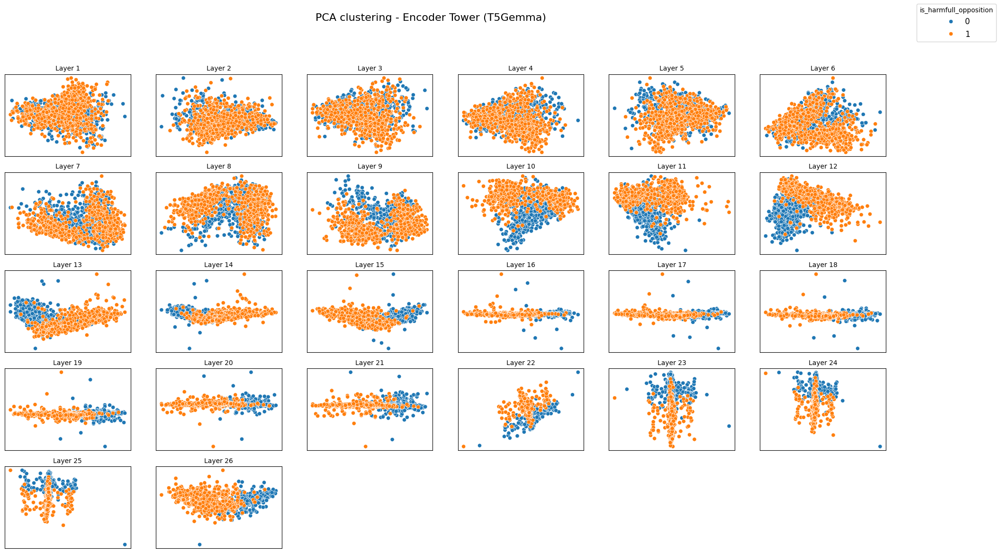

In [ ]:
# ──────────────────────────────────────────────────────────────────────────────
# 4‑A. Encoder tower  (mean token works best)
# ──────────────────────────────────────────────────────────────────────────────
print("\n► Extracting *encoder* embeddings …")
X_pos_enc = embed_and_normalise(hate_total_yes_data['statement'],
                                tower_tag="enc_pos",
                                strategy="mean",
                                use_decoder=False,
                                model=model,
                                tokenizer=tokenizer)

X_neg_enc = embed_and_normalise(hate_total_no_data['statement'],
                                tower_tag="enc_neg",
                                strategy="mean",
                                use_decoder=False,
                                model=model,
                                tokenizer=tokenizer)

# CHANGED: Convert GPU tensors to CPU numpy arrays for plotting
X_pos_enc = X_pos_enc.cpu().numpy()
X_neg_enc = X_neg_enc.cpu().numpy()

print("\n► Plotting PCA for *encoder* embeddings …")
plot_pca_or_tsne_layerwise(X_pos_enc,
                           X_neg_enc,
                           hate_data['is_harmfull_opposition'],
                           standardize=False, n_components=5,
                           components=[0, 1], mode='pca',
                           plot_title='PCA clustering - Encoder Tower (T5Gemma)')

Added /Users/elenaericheva/ericheva_git/ccs_aisf/code to Python path

► Plotting PCA for *encoder* embeddings …


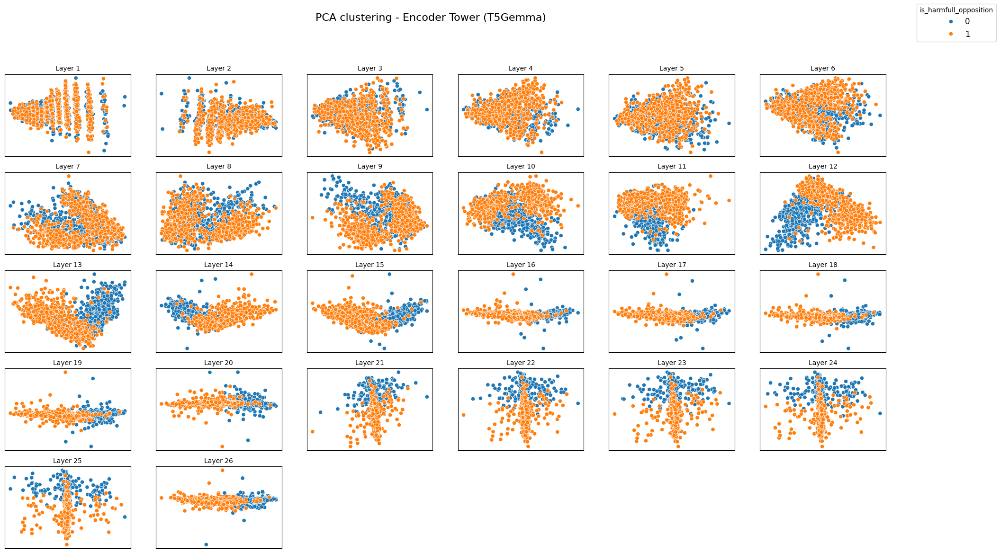

In [5]:
# recheck for env_mean
#######
#######
#######
import sys
import os

# Add the code directory directly to Python path
code_dir = '/Users/elenaericheva/ericheva_git/ccs_aisf/code'
if code_dir not in sys.path:
    sys.path.insert(0, code_dir)

print(f"Added {code_dir} to Python path")

import numpy as np
import pandas as pd
from format_results_fixed import plot_pca_or_tsne_layerwise

YOUR_NAME = "t5gemma-2b-2b-ul2-it"
strategy = "mean"
hate_data = pd.read_csv('../data/raw/total_hate3.0.csv', index_col=0)
X_pos_enc = np.load(f"{YOUR_NAME}_enc_pos_{strategy}_not.npz")['arr_0']
X_neg_enc = np.load(f"{YOUR_NAME}_enc_neg_{strategy}_not.npz")['arr_0']

print("\n► Plotting PCA for *encoder* embeddings …")
plot_pca_or_tsne_layerwise(X_pos_enc,
                           X_neg_enc,
                           hate_data['is_harmfull_opposition'],
                           standardize=False, n_components=5,
                           components=[0, 1], mode='pca',
                           plot_title='PCA clustering - Encoder Tower (T5Gemma)')

#######
#######
#######


► Extracting *decoder* embeddings …


Extracting embeddings (strategy: first-token): 100%|██████████| 1250/1250 [12:57<00:00,  1.61it/s]


Extraction completed: shape=torch.Size([1250, 27, 2304]), dtype=torch.float32, device=cpu
Stats: max=948.000, min=-408.000, std=15.893


Extracting embeddings (strategy: first-token): 100%|██████████| 1250/1250 [12:53<00:00,  1.62it/s]


Extraction completed: shape=torch.Size([1250, 27, 2304]), dtype=torch.float32, device=cpu
Stats: max=952.000, min=-410.000, std=15.886

► Plotting PCA for *encoder* embeddings …


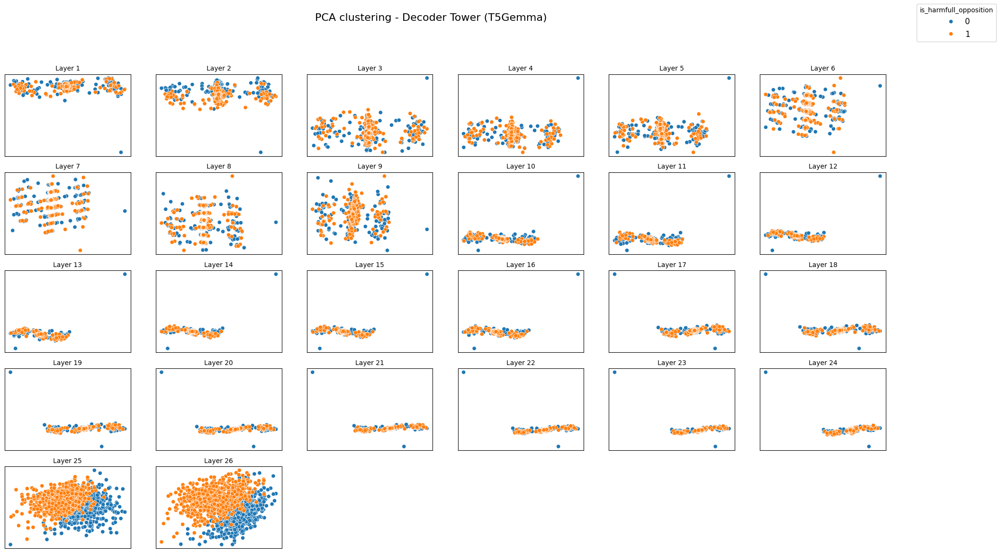

In [ ]:
# ──────────────────────────────────────────────────────────────────────────────
# 4‑B. Decoder tower  (last token works best)
# ──────────────────────────────────────────────────────────────────────────────
print("\n► Extracting *decoder* embeddings …")
X_pos_dec = embed_and_normalise(hate_total_yes_data['statement'],
                                tower_tag="dec_pos",
                                strategy="first-token",
                                use_decoder=True,
                                model=model,
                                tokenizer=tokenizer)

X_neg_dec = embed_and_normalise(hate_total_no_data['statement'],
                                tower_tag="dec_neg",
                                strategy="first-token",
                                use_decoder=True,
                                model=model,
                                tokenizer=tokenizer)

# CHANGED: Convert GPU tensors to CPU numpy arrays for plotting
X_pos_dec = X_pos_dec.cpu().numpy()
X_neg_dec = X_neg_dec.cpu().numpy()

print("\n► Plotting PCA for *encoder* embeddings …")
plot_pca_or_tsne_layerwise(X_pos_dec,
                           X_neg_dec,
                           hate_data['is_harmfull_opposition'],
                           standardize=False, n_components=5,
                           components=[0, 1], mode='pca',
                           plot_title='PCA clustering - Decoder Tower (T5Gemma)')


► Extracting *encoder* embeddings …


Extracting embeddings (strategy: mean): 100%|██████████| 1250/1250 [12:55<00:00,  1.61it/s]


Extraction completed: shape=torch.Size([1250, 27, 2304]), dtype=torch.float32, device=cpu
Stats: max=165.219, min=-112.567, std=2.544


Extracting embeddings (strategy: mean): 100%|██████████| 1250/1250 [12:41<00:00,  1.64it/s]


Extraction completed: shape=torch.Size([1250, 27, 2304]), dtype=torch.float32, device=cpu
Stats: max=166.500, min=-110.750, std=2.548

► Plotting PCA for *encoder* embeddings …


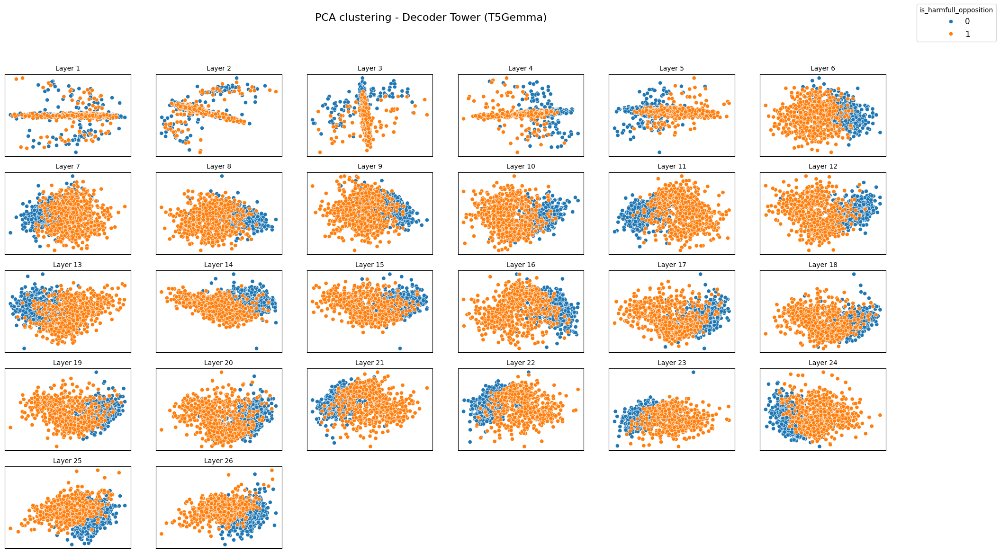

In [ ]:
# ──────────────────────────────────────────────────────────────────────────────
# 4‑B. Decoder tower  (last token works best)
# ──────────────────────────────────────────────────────────────────────────────
print("\n► Extracting *encoder* embeddings …")
X_pos_dec = embed_and_normalise(hate_total_yes_data['statement'],
                                tower_tag="dec_pos",
                                strategy="mean",
                                use_decoder=True,
                                model=model,
                                tokenizer=tokenizer)

X_neg_dec = embed_and_normalise(hate_total_no_data['statement'],
                                tower_tag="dec_neg",
                                strategy="mean",
                                use_decoder=True,
                                model=model,
                                tokenizer=tokenizer)

# CHANGED: Convert GPU tensors to CPU numpy arrays for plotting
X_pos_dec = X_pos_dec.cpu().numpy()
X_neg_dec = X_neg_dec.cpu().numpy()

print("\n► Plotting PCA for *encoder* embeddings …")
plot_pca_or_tsne_layerwise(X_pos_dec,
                           X_neg_dec,
                           hate_data['is_harmfull_opposition'],
                           standardize=False, n_components=5,
                           components=[0, 1], mode='pca',
                           plot_title='PCA clustering - Decoder Tower (T5Gemma)')


► Extracting *encoder* embeddings …


Extracting embeddings (strategy: last-token): 100%|██████████| 1250/1250 [13:21<00:00,  1.56it/s]


Extraction completed: shape=torch.Size([1250, 27, 2304]), dtype=torch.float32, device=cpu
Stats: max=73.000, min=-134.000, std=3.234


Extracting embeddings (strategy: last-token): 100%|██████████| 1250/1250 [15:28<00:00,  1.35it/s]


Extraction completed: shape=torch.Size([1250, 27, 2304]), dtype=torch.float32, device=cpu
Stats: max=79.000, min=-140.000, std=3.198

► Plotting PCA for *encoder* embeddings …


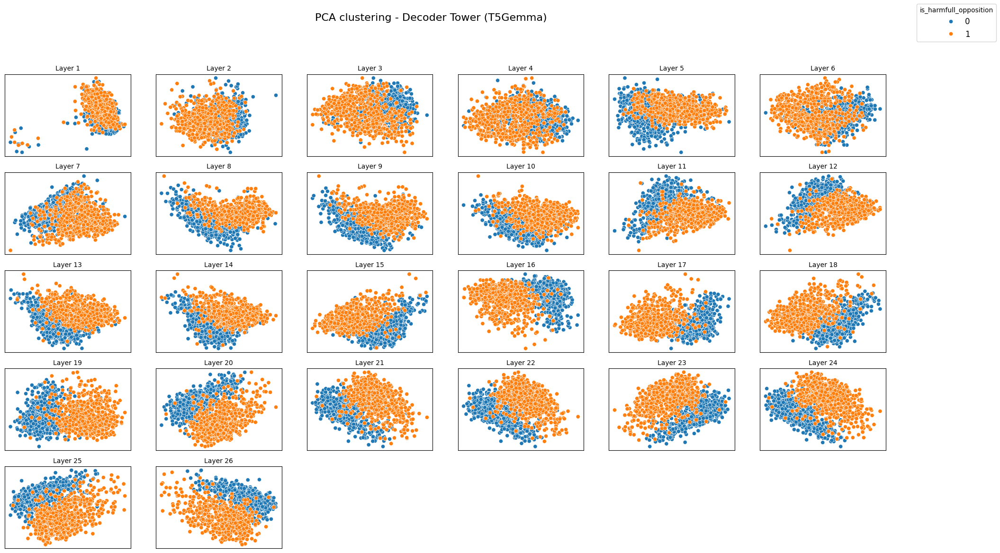

In [ ]:
# ──────────────────────────────────────────────────────────────────────────────
# 4‑B. Decoder tower  (last token works best)
# ──────────────────────────────────────────────────────────────────────────────
print("\n► Extracting *encoder* embeddings …")
X_pos_dec = embed_and_normalise(hate_total_yes_data['statement'],
                                tower_tag="dec_pos",
                                strategy="last-token",
                                use_decoder=True,
                                model=model,
                                tokenizer=tokenizer)

X_neg_dec = embed_and_normalise(hate_total_no_data['statement'],
                                tower_tag="dec_neg",
                                strategy="last-token",
                                use_decoder=True,
                                model=model,
                                tokenizer=tokenizer)

# CHANGED: Convert GPU tensors to CPU numpy arrays for plotting
X_pos_dec = X_pos_dec.cpu().numpy()
X_neg_dec = X_neg_dec.cpu().numpy()

print("\n► Plotting PCA for *encoder* embeddings …")
plot_pca_or_tsne_layerwise(X_pos_dec,
                           X_neg_dec,
                           hate_data['is_harmfull_opposition'],
                           standardize=False, n_components=5,
                           components=[0, 1], mode='pca',
                           plot_title='PCA clustering - Decoder Tower (T5Gemma)')

Added /Users/elenaericheva/ericheva_git/ccs_aisf/code to Python path

► Plotting PCA for *encoder* embeddings …


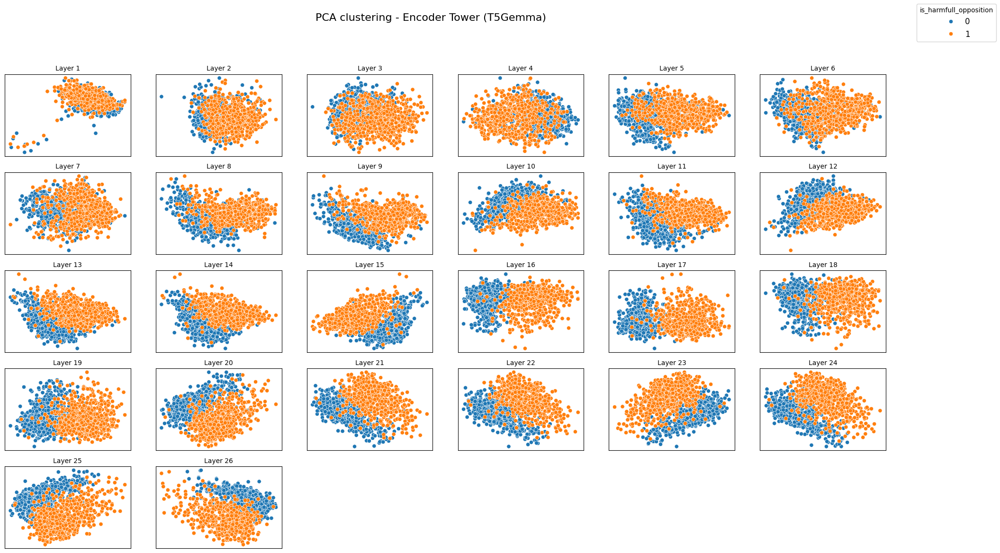

In [6]:
# recheck for dec_last-token
#######
#######
#######
import sys
import os

# Add the code directory directly to Python path
code_dir = '/Users/elenaericheva/ericheva_git/ccs_aisf/code'
if code_dir not in sys.path:
    sys.path.insert(0, code_dir)

print(f"Added {code_dir} to Python path")

import numpy as np
import pandas as pd
from format_results_fixed import plot_pca_or_tsne_layerwise

YOUR_NAME = "t5gemma-2b-2b-ul2-it"
strategy = "last-token"
hate_data = pd.read_csv('../data/raw/total_hate3.0.csv', index_col=0)
X_pos_dec = np.load(f"{YOUR_NAME}_dec_pos_{strategy}_not.npz")['arr_0']
X_neg_dec = np.load(f"{YOUR_NAME}_dec_neg_{strategy}_not.npz")['arr_0']

print("\n► Plotting PCA for *encoder* embeddings …")
plot_pca_or_tsne_layerwise(X_pos_dec,
                           X_neg_dec,
                           hate_data['is_harmfull_opposition'],
                           standardize=False, n_components=5,
                           components=[0, 1], mode='pca',
                           plot_title='PCA clustering - Encoder Tower (T5Gemma)')

#######
#######
#######

Median normalize used
Layer 1/27, CCS accuracy: 0.528
Median normalize used
Layer 2/27, CCS accuracy: 0.536
Median normalize used
Layer 3/27, CCS accuracy: 0.536
Median normalize used
Layer 4/27, CCS accuracy: 0.56
Median normalize used
Layer 5/27, CCS accuracy: 0.6
Median normalize used
Layer 6/27, CCS accuracy: 0.5800000000000001
Median normalize used
Layer 7/27, CCS accuracy: 0.556
Median normalize used
Layer 8/27, CCS accuracy: 0.5680000000000001
Median normalize used
Layer 9/27, CCS accuracy: 0.568
Median normalize used
Layer 10/27, CCS accuracy: 0.5680000000000001
Median normalize used
Layer 11/27, CCS accuracy: 0.548
Median normalize used
Layer 12/27, CCS accuracy: 0.556
Median normalize used
Layer 13/27, CCS accuracy: 0.56
Median normalize used
Layer 14/27, CCS accuracy: 0.936
Median normalize used
Layer 15/27, CCS accuracy: 0.94
Median normalize used
Layer 16/27, CCS accuracy: 0.952
Median normalize used
Layer 17/27, CCS accuracy: 0.956
Median normalize used
Layer 18/27, CCS a

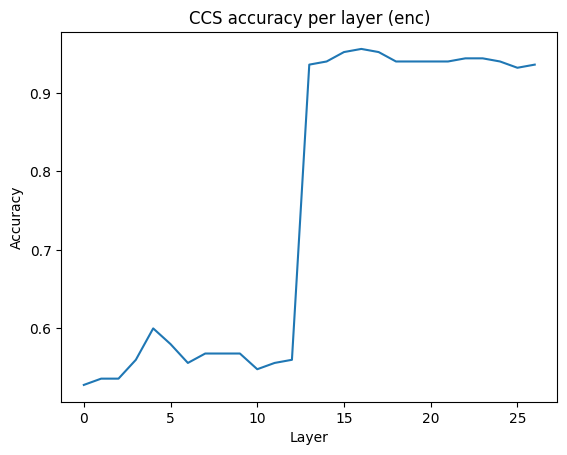

► Best enc layer = 16  (acc=0.956)


In [ ]:
import sys
import os

# Add the code directory directly to Python path
code_dir = '/Users/elenaericheva/ericheva_git/ccs_aisf/code'
if code_dir not in sys.path:
    sys.path.insert(0, code_dir)

print(f"Added {code_dir} to Python path")

import random, numpy as np, torch, pickle, matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from ccs import train_ccs_on_hidden_states
import pandas as pd


SEED = 42
random.seed(SEED); np.random.seed(SEED); torch.manual_seed(SEED)
torch.backends.cudnn.deterministic, torch.backends.cudnn.benchmark = True, False

def run_ccs(X_pos_norm, X_neg_norm, *, tower_tag):
    # Train / test split once per tower
    idx              = np.arange(len(X_pos_norm))
    train_idx, test_idx = train_test_split(idx, test_size=0.2,
                                           random_state=71, shuffle=True)

    # CCS
    ccs_layers = train_ccs_on_hidden_states(X_pos_norm,
                                            X_neg_norm,
                                            hate_data['is_harmfull_opposition'],
                                            train_idx, test_idx,
                                            normalizing='median')

    # save
    with open(f'ccs_{YOUR_NAME}_{tower_tag}_not_results.pkl', 'wb') as f:
        pickle.dump(ccs_layers, f)

    # Accuracy curve
    acc = [layer_data['accuracy'] for layer_idx, layer_data in ccs_layers.items()]
    plt.figure(); plt.plot(acc); plt.title(f'CCS accuracy per layer ({tower_tag})')
    plt.xlabel('Layer'); plt.ylabel('Accuracy'); plt.show()

    # Best layer
    best_layer = int(np.argmax(acc))
    print(f'► Best {tower_tag} layer = {best_layer}  (acc={acc[best_layer]:.3f})')
    return best_layer

# best_enc_layer = run_ccs(X_pos_enc, X_neg_enc, tower_tag='enc')


In [ ]:
YOUR_NAME = "t5gemma-2b-2b-ul2-it"
strategy = "first-token"
hate_data = pd.read_csv('../data/raw/total_hate3.0.csv', index_col=0)
X_pos_enc = np.load(f"{YOUR_NAME}_enc_pos_{strategy}.npz")['arr_0']
X_neg_enc = np.load(f"{YOUR_NAME}_enc_neg_{strategy}.npz")['arr_0']
best_enc_layer = run_ccs(X_pos_enc, X_neg_enc, tower_tag=f'enc_{strategy}')

In [ ]:
YOUR_NAME = "t5gemma-2b-2b-ul2-it"
strategy = "last-token"
hate_data = pd.read_csv('../data/raw/total_hate3.0.csv', index_col=0)
X_pos_enc = np.load(f"{YOUR_NAME}_enc_pos_{strategy}.npz")['arr_0']
X_neg_enc = np.load(f"{YOUR_NAME}_enc_neg_{strategy}.npz")['arr_0']
best_enc_layer = run_ccs(X_pos_enc, X_neg_enc, tower_tag=f'enc_{strategy}')

In [ ]:
YOUR_NAME = "t5gemma-2b-2b-ul2-it"
strategy = "first-token"
hate_data = pd.read_csv('../data/raw/total_hate3.0.csv', index_col=0)
X_pos_dec = np.load(f"{YOUR_NAME}_dec_pos_{strategy}_not.npz")['arr_0']
X_neg_dec = np.load(f"{YOUR_NAME}_dec_neg_{strategy}_not.npz")['arr_0']
best_dec_layer = run_ccs(X_pos_dec, X_neg_dec, tower_tag=f'dec_{strategy}')

In [ ]:
YOUR_NAME = "t5gemma-2b-2b-ul2-it"
strategy = "mean"
hate_data = pd.read_csv('../data/raw/total_hate3.0.csv', index_col=0)
X_pos_dec = np.load(f"{YOUR_NAME}_dec_pos_{strategy}_not.npz")['arr_0']
X_neg_dec = np.load(f"{YOUR_NAME}_dec_neg_{strategy}_not.npz")['arr_0']
best_dec_layer = run_ccs(X_pos_dec, X_neg_dec, tower_tag=f'dec_{strategy}')

In [ ]:
# !!!!!!!!!
YOUR_NAME = "t5gemma-2b-2b-ul2-it"
strategy = "mean"
hate_data = pd.read_csv('../data/raw/total_hate3.0.csv', index_col=0)
X_pos_enc = np.load(f"{YOUR_NAME}_enc_pos_{strategy}.npz")['arr_0']
X_neg_enc = np.load(f"{YOUR_NAME}_enc_neg_{strategy}.npz")['arr_0']
best_enc_layer = run_ccs(X_pos_enc, X_neg_enc, tower_tag=f'enc_{strategy}')

Median normalize used
Layer 1/27, CCS accuracy: 0.516
Median normalize used
Layer 2/27, CCS accuracy: 0.5840000000000001
Median normalize used
Layer 3/27, CCS accuracy: 0.604
Median normalize used
Layer 4/27, CCS accuracy: 0.564
Median normalize used
Layer 5/27, CCS accuracy: 0.556
Median normalize used
Layer 6/27, CCS accuracy: 0.792
Median normalize used
Layer 7/27, CCS accuracy: 0.784
Median normalize used
Layer 8/27, CCS accuracy: 0.8280000000000001
Median normalize used
Layer 9/27, CCS accuracy: 0.86
Median normalize used
Layer 10/27, CCS accuracy: 0.86
Median normalize used
Layer 11/27, CCS accuracy: 0.856
Median normalize used
Layer 12/27, CCS accuracy: 0.896
Median normalize used
Layer 13/27, CCS accuracy: 0.944
Median normalize used
Layer 14/27, CCS accuracy: 0.956
Median normalize used
Layer 15/27, CCS accuracy: 0.96
Median normalize used
Layer 16/27, CCS accuracy: 0.96
Median normalize used
Layer 17/27, CCS accuracy: 0.96
Median normalize used
Layer 18/27, CCS accuracy: 0.96

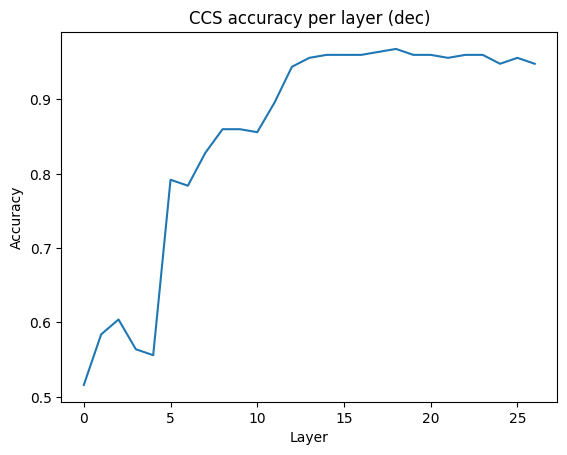

► Best dec layer = 18  (acc=0.968)


In [ ]:
# !!!!!!!!!
YOUR_NAME = "t5gemma-2b-2b-ul2-it"
strategy = "last-token"
hate_data = pd.read_csv('../data/raw/total_hate3.0.csv', index_col=0)
X_pos_dec = np.load(f"{YOUR_NAME}_dec_pos_{strategy}_not.npz")['arr_0']
X_neg_dec = np.load(f"{YOUR_NAME}_dec_neg_{strategy}_not.npz")['arr_0']
best_dec_layer = run_ccs(X_pos_dec, X_neg_dec, tower_tag=f'dec_{strategy}')


In [ ]:
1/0

In [ ]:
from ccs import CCS
import pandas as pd, numpy as np, pickle
from sklearn.model_selection import train_test_split

def single_layer_ccs(X_pos_norm, X_neg_norm, best_layer, *, tower_tag):
    # Slice out the chosen layer
    X_pos_layer = pd.DataFrame(X_pos_norm[:, best_layer])
    X_neg_layer = pd.DataFrame(X_neg_norm[:, best_layer])

    idx = np.arange(len(X_pos_norm))
    train_idx, test_idx = train_test_split(idx, test_size=0.2,
                                           random_state=71, shuffle=True)

    # Train/test split
    X_pos_train = X_pos_layer.loc[train_idx].values.astype(np.float32)
    X_pos_test  = X_pos_layer.loc[test_idx].values.astype(np.float32)
    X_neg_train = X_neg_layer.loc[train_idx].values.astype(np.float32)
    X_neg_test  = X_neg_layer.loc[test_idx].values.astype(np.float32)

    y_train = hate_data['is_harmfull_opposition'][train_idx]
    y_test  = hate_data['is_harmfull_opposition'][test_idx]

    # Median normalise in‑place
    X_pos_train -= np.median(X_pos_train); X_pos_test -= np.median(X_pos_train)
    X_neg_train -= np.median(X_neg_train); X_neg_test -= np.median(X_neg_train)

    # CCS without labels (NEG first, then POS)
    ccs = CCS(X_neg_train, X_pos_train, y_train.values,
              var_normalize=False, lambda_classification=0,
              predict_normalize=False)
    ccs.repeated_train()

    acc = ccs.get_acc(X_neg_test, X_pos_test, y_test.values)
    print(f'CCS accuracy ({tower_tag}, layer {best_layer}) = {acc:.3f}')

    with open(f'ccs_{YOUR_NAME}_{tower_tag}_not_l{best_layer}.pkl', 'wb') as f:
        pickle.dump(ccs, f)

# Run for both towers
# Run for both towers
hate_data = pd.read_csv('../data/raw/total_hate3.0.csv.csv', index_col=0)
strategy = "mean"
X_pos_enc = np.load(f"{YOUR_NAME}_enc_pos_{strategy}_not.npz")['arr_0']
X_neg_enc = np.load(f"{YOUR_NAME}_enc_neg_{strategy}_not.npz")['arr_0']
single_layer_ccs(X_pos_enc, X_neg_enc, best_enc_layer, tower_tag=f'enc_{strategy}')
strategy = "first-token"
X_pos_enc = np.load(f"{YOUR_NAME}_enc_pos_{strategy}_not.npz")['arr_0']
X_neg_enc = np.load(f"{YOUR_NAME}_enc_neg_{strategy}_not.npz")['arr_0']
single_layer_ccs(X_pos_enc, X_neg_enc, best_enc_layer, tower_tag=f'enc_{strategy}')

best_enc_layer = 16
strategy = "last-token"
X_pos_enc = np.load(f"{YOUR_NAME}_enc_pos_{strategy}_not.npz")['arr_0']
X_neg_enc = np.load(f"{YOUR_NAME}_enc_neg_{strategy}_not.npz")['arr_0']
single_layer_ccs(X_pos_enc, X_neg_enc, best_enc_layer, tower_tag=f'enc_{strategy}!!!!')

print("")
strategy = "first-token"
X_pos_dec = np.load(f"{YOUR_NAME}_dec_pos_{strategy}_not.npz")['arr_0']
X_neg_dec = np.load(f"{YOUR_NAME}_dec_neg_{strategy}_not.npz")['arr_0']
single_layer_ccs(X_pos_dec, X_neg_dec, best_dec_layer, tower_tag=f'dec_{strategy}')
strategy = "mean"
X_pos_dec = np.load(f"{YOUR_NAME}_dec_pos_{strategy}_not.npz")['arr_0']
X_neg_dec = np.load(f"{YOUR_NAME}_dec_neg_{strategy}_not.npz")['arr_0']
single_layer_ccs(X_pos_dec, X_neg_dec, best_dec_layer, tower_tag=f'dec_{strategy}')

best_dec_layer = 18
strategy = "last-token"
X_pos_dec = np.load(f"{YOUR_NAME}_dec_pos_{strategy}_not.npz")['arr_0']
X_neg_dec = np.load(f"{YOUR_NAME}_dec_neg_{strategy}_not.npz")['arr_0']
single_layer_ccs(X_pos_dec, X_neg_dec, best_dec_layer, tower_tag=f'dec_{strategy}!!!!')


CCS accuracy (enc, layer 16) = 0.932
CCS accuracy (dec, layer 18) = 0.960


In [ ]:
1/0

# TTT


► Extracting *encoder* embeddings …


Extracting embeddings (strategy: first-token): 100%|██████████| 1250/1250 [09:11<00:00,  2.27it/s]


Extraction completed: shape=torch.Size([1250, 27, 2304]), dtype=torch.float32, device=cpu
Stats: max=231.000, min=-556.000, std=3.773


Extracting embeddings (strategy: first-token): 100%|██████████| 1250/1250 [09:27<00:00,  2.20it/s]


Extraction completed: shape=torch.Size([1250, 27, 2304]), dtype=torch.float32, device=cpu
Stats: max=270.000, min=-976.000, std=3.770

► Plotting PCA for *encoder* embeddings …


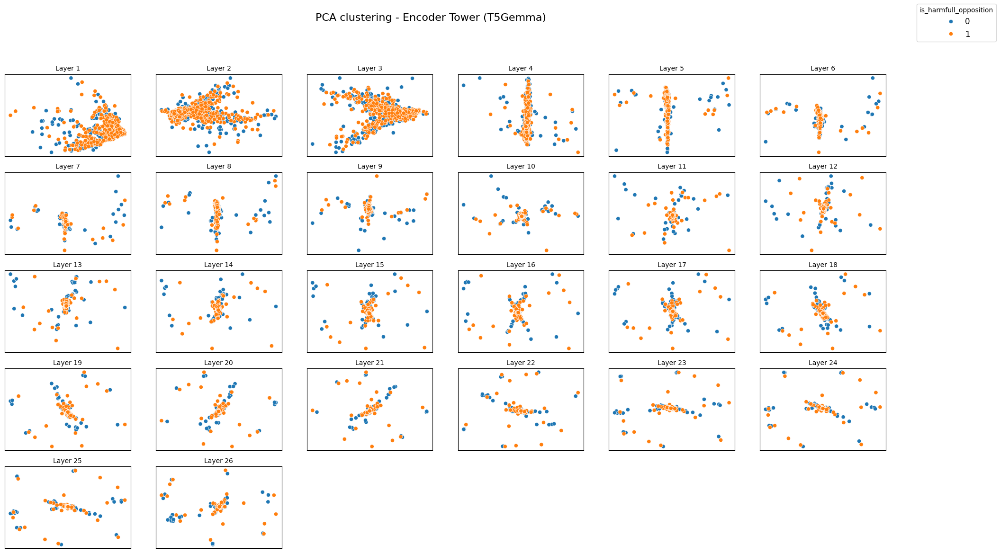

In [ ]:
import torch
import pandas as pd
import numpy as np
from extract_fixed_t5gemma import vectorize_df
from format_results_fixed import plot_pca_or_tsne_layerwise


# ──────────────────────────────────────────────────────────────────────────────
# 2. Load your datasets
# ──────────────────────────────────────────────────────────────────────────────

hate_data           = pd.read_csv('../data/raw/total_hate3.0.csv', index_col=0)
hate_total_yes_data = pd.read_csv('../data/yes_no/hate_total3.0_yes.csv', index_col=0)
hate_total_no_data  = pd.read_csv('../data/yes_no/hate_total3.0_no.csv',  index_col=0)

hate_total_yes_data['statement'] = hate_total_yes_data['statement'].apply(
                                    lambda x: x.replace('not', 'ttt').replace('Not', 'ttt'))
hate_total_no_data['statement'] = hate_total_no_data['statement'].apply(
                                        lambda x: x.replace('not', 'ttt').replace('Not', 'ttt'))

# ──────────────────────────────────────────────────────────────────────────────
# 3. Helper to run vectorise‑>save‑>normalise in one go
# ──────────────────────────────────────────────────────────────────────────────
def embed_and_normalise(df_text, tower_tag, strategy, use_decoder, model, tokenizer):
    """Returns L2‑normalised (n_samples, n_layers, dim) GPU tensor"""
    # CHANGED: Use GPU device and return GPU tensor
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    
    X = vectorize_df(df_text,
                     model, tokenizer,
                     strategy=strategy, 
                     model_type="encoder-decoder",
                     use_decoder=use_decoder,
                     get_all_hs=True,
                     device=device)  # CHANGED: Use GPU

    # CHANGED: Save CPU version but keep GPU tensor for return
    np.savez_compressed(f"{YOUR_NAME}_{tower_tag}_{strategy}_ttt.npz", X.cpu().numpy())

    # CHANGED: L2-normalize on GPU
    X_flat = X.view(-1, X.shape[-1])
    X_norm = torch.nn.functional.normalize(X_flat, p=2, dim=1).view(X.shape)

    # CHANGED: Save normalized version
    # np.savez_compressed(f"{YOUR_NAME}_{tower_tag}_{strategy}_norm.npz", X_norm.cpu().numpy())
    return X_norm  # CHANGED: Return GPU tensor

# ──────────────────────────────────────────────────────────────────────────────
# 4‑A. Encoder tower  (mean token works best)
# ──────────────────────────────────────────────────────────────────────────────
print("\n► Extracting *encoder* embeddings …")
X_pos_enc = embed_and_normalise(hate_total_yes_data['statement'],
                                tower_tag="enc_pos",
                                strategy="first-token",
                                use_decoder=False,
                                model=model,
                                tokenizer=tokenizer)

X_neg_enc = embed_and_normalise(hate_total_no_data['statement'],
                                tower_tag="enc_neg",
                                strategy="first-token",
                                use_decoder=False,
                                model=model,
                                tokenizer=tokenizer)

# CHANGED: Convert GPU tensors to CPU numpy arrays for plotting
X_pos_enc = X_pos_enc.cpu().numpy()
X_neg_enc = X_neg_enc.cpu().numpy()

print("\n► Plotting PCA for *encoder* embeddings …")
plot_pca_or_tsne_layerwise(X_pos_enc,
                           X_neg_enc,
                           hate_data['is_harmfull_opposition'],
                           standardize=False, n_components=5,
                           components=[0, 1], mode='pca',
                           plot_title='PCA clustering - Encoder Tower (T5Gemma)')







► Extracting *encoder* embeddings …


Extracting embeddings (strategy: last-token): 100%|██████████| 1250/1250 [09:18<00:00,  2.24it/s]


Extraction completed: shape=torch.Size([1250, 27, 2304]), dtype=torch.float32, device=cpu
Stats: max=133.000, min=-310.000, std=3.731


Extracting embeddings (strategy: last-token): 100%|██████████| 1250/1250 [10:11<00:00,  2.04it/s]


Extraction completed: shape=torch.Size([1250, 27, 2304]), dtype=torch.float32, device=cpu
Stats: max=110.000, min=-197.000, std=3.700

► Plotting PCA for *encoder* embeddings …


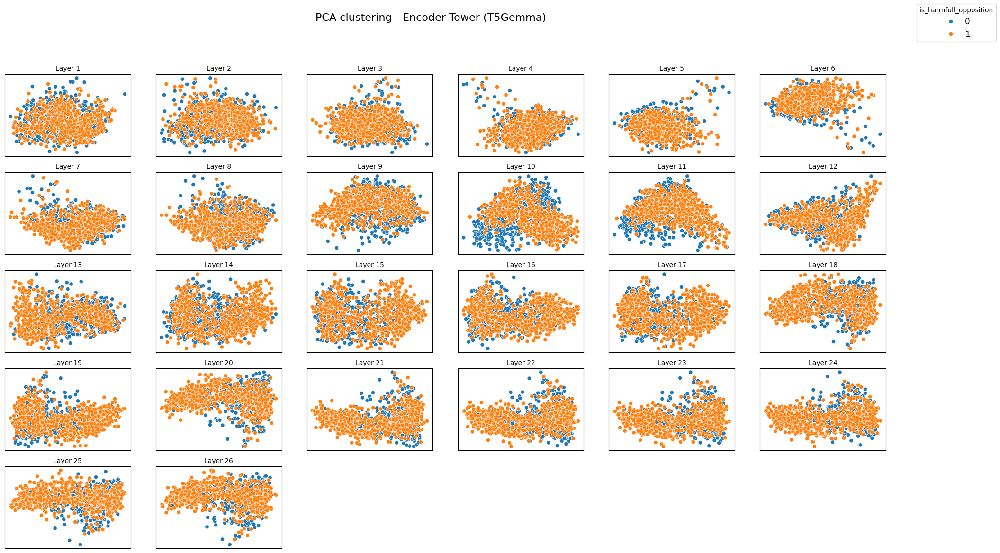

In [ ]:
# ──────────────────────────────────────────────────────────────────────────────
# 4‑A. Encoder tower  (mean token works best)
# ──────────────────────────────────────────────────────────────────────────────
print("\n► Extracting *encoder* embeddings …")
X_pos_enc = embed_and_normalise(hate_total_yes_data['statement'],
                                tower_tag="enc_pos",
                                strategy="last-token",
                                use_decoder=False,
                                model=model,
                                tokenizer=tokenizer)

X_neg_enc = embed_and_normalise(hate_total_no_data['statement'],
                                tower_tag="enc_neg",
                                strategy="last-token",
                                use_decoder=False,
                                model=model,
                                tokenizer=tokenizer)

# CHANGED: Convert GPU tensors to CPU numpy arrays for plotting
X_pos_enc = X_pos_enc.cpu().numpy()
X_neg_enc = X_neg_enc.cpu().numpy()

print("\n► Plotting PCA for *encoder* embeddings …")
plot_pca_or_tsne_layerwise(X_pos_enc,
                           X_neg_enc,
                           hate_data['is_harmfull_opposition'],
                           standardize=False, n_components=5,
                           components=[0, 1], mode='pca',
                           plot_title='PCA clustering - Encoder Tower (T5Gemma)')


► Extracting *encoder* embeddings …


Extracting embeddings (strategy: mean): 100%|██████████| 1250/1250 [10:03<00:00,  2.07it/s]


Extraction completed: shape=torch.Size([1250, 27, 2304]), dtype=torch.float32, device=cpu
Stats: max=225.018, min=-559.000, std=3.162


Extracting embeddings (strategy: mean): 100%|██████████| 1250/1250 [09:21<00:00,  2.23it/s]


Extraction completed: shape=torch.Size([1250, 27, 2304]), dtype=torch.float32, device=cpu
Stats: max=220.143, min=-569.786, std=3.118

► Plotting PCA for *encoder* embeddings …


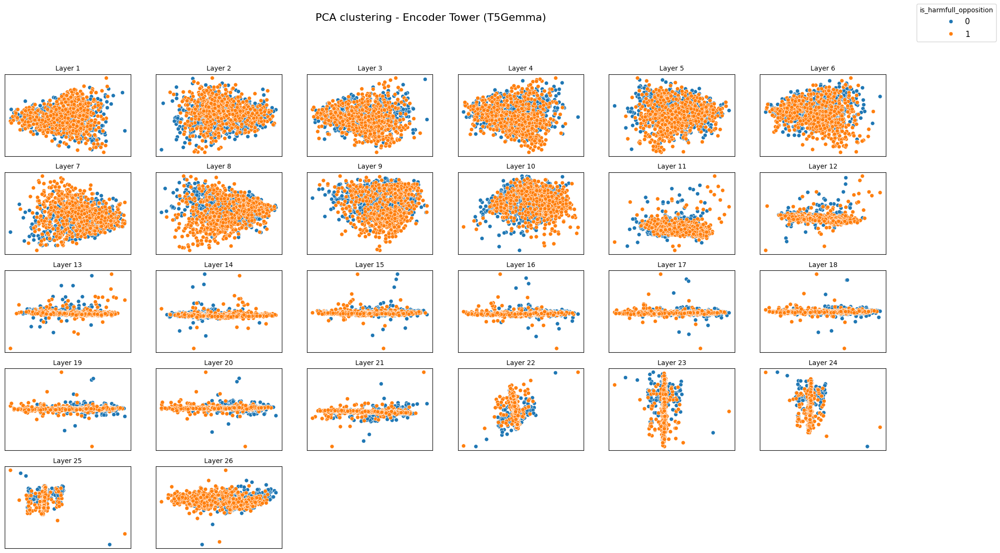

In [ ]:
# ──────────────────────────────────────────────────────────────────────────────
# 4‑A. Encoder tower  (mean token works best)
# ──────────────────────────────────────────────────────────────────────────────
print("\n► Extracting *encoder* embeddings …")
X_pos_enc = embed_and_normalise(hate_total_yes_data['statement'],
                                tower_tag="enc_pos",
                                strategy="mean",
                                use_decoder=False,
                                model=model,
                                tokenizer=tokenizer)

X_neg_enc = embed_and_normalise(hate_total_no_data['statement'],
                                tower_tag="enc_neg",
                                strategy="mean",
                                use_decoder=False,
                                model=model,
                                tokenizer=tokenizer)

# CHANGED: Convert GPU tensors to CPU numpy arrays for plotting
X_pos_enc = X_pos_enc.cpu().numpy()
X_neg_enc = X_neg_enc.cpu().numpy()

print("\n► Plotting PCA for *encoder* embeddings …")
plot_pca_or_tsne_layerwise(X_pos_enc,
                           X_neg_enc,
                           hate_data['is_harmfull_opposition'],
                           standardize=False, n_components=5,
                           components=[0, 1], mode='pca',
                           plot_title='PCA clustering - Encoder Tower (T5Gemma)')

Added /Users/elenaericheva/ericheva_git/ccs_aisf/code to Python path

► Plotting PCA for *encoder* embeddings …


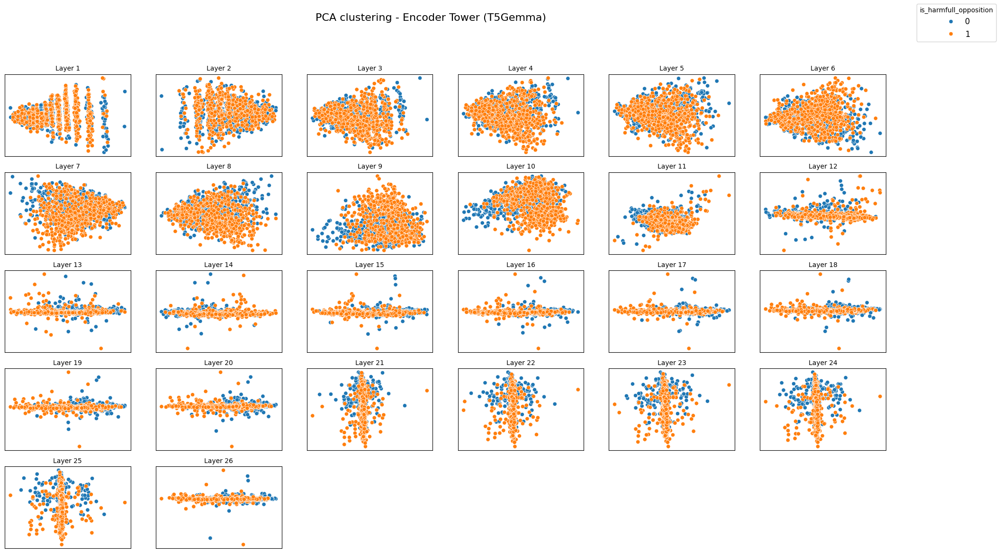

In [7]:
# recheck for env_mean
#######
#######
#######
import sys
import os

# Add the code directory directly to Python path
code_dir = '/Users/elenaericheva/ericheva_git/ccs_aisf/code'
if code_dir not in sys.path:
    sys.path.insert(0, code_dir)

print(f"Added {code_dir} to Python path")

import numpy as np
import pandas as pd
from format_results_fixed import plot_pca_or_tsne_layerwise

YOUR_NAME = "t5gemma-2b-2b-ul2-it"
strategy = "mean"
hate_data = pd.read_csv('../data/raw/total_hate3.0.csv', index_col=0)
X_pos_enc = np.load(f"{YOUR_NAME}_enc_pos_{strategy}_ttt.npz")['arr_0']
X_neg_enc = np.load(f"{YOUR_NAME}_enc_neg_{strategy}_ttt.npz")['arr_0']

print("\n► Plotting PCA for *encoder* embeddings …")
plot_pca_or_tsne_layerwise(X_pos_enc,
                           X_neg_enc,
                           hate_data['is_harmfull_opposition'],
                           standardize=False, n_components=5,
                           components=[0, 1], mode='pca',
                           plot_title='PCA clustering - Encoder Tower (T5Gemma)')

#######
#######
#######


► Extracting *decoder* embeddings …


Extracting embeddings (strategy: first-token): 100%|██████████| 1250/1250 [17:44<00:00,  1.17it/s]


Extraction completed: shape=torch.Size([1250, 27, 2304]), dtype=torch.float32, device=cpu
Stats: max=952.000, min=-408.000, std=15.897


Extracting embeddings (strategy: first-token): 100%|██████████| 1250/1250 [15:57<00:00,  1.31it/s]


Extraction completed: shape=torch.Size([1250, 27, 2304]), dtype=torch.float32, device=cpu
Stats: max=948.000, min=-410.000, std=15.883

► Plotting PCA for *encoder* embeddings …


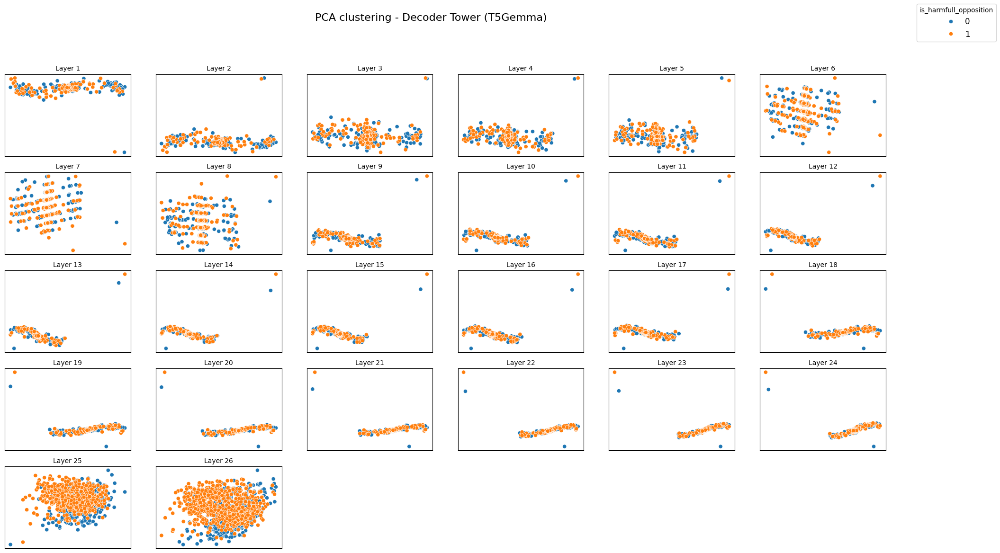

In [ ]:
# ──────────────────────────────────────────────────────────────────────────────
# 4‑B. Decoder tower  (last token works best)
# ──────────────────────────────────────────────────────────────────────────────
print("\n► Extracting *decoder* embeddings …")
X_pos_dec = embed_and_normalise(hate_total_yes_data['statement'],
                                tower_tag="dec_pos",
                                strategy="first-token",
                                use_decoder=True,
                                model=model,
                                tokenizer=tokenizer)

X_neg_dec = embed_and_normalise(hate_total_no_data['statement'],
                                tower_tag="dec_neg",
                                strategy="first-token",
                                use_decoder=True,
                                model=model,
                                tokenizer=tokenizer)

# CHANGED: Convert GPU tensors to CPU numpy arrays for plotting
X_pos_dec = X_pos_dec.cpu().numpy()
X_neg_dec = X_neg_dec.cpu().numpy()

print("\n► Plotting PCA for *encoder* embeddings …")
plot_pca_or_tsne_layerwise(X_pos_dec,
                           X_neg_dec,
                           hate_data['is_harmfull_opposition'],
                           standardize=False, n_components=5,
                           components=[0, 1], mode='pca',
                           plot_title='PCA clustering - Decoder Tower (T5Gemma)')


► Extracting *encoder* embeddings …


Extracting embeddings (strategy: mean): 100%|██████████| 1250/1250 [17:48<00:00,  1.17it/s]


Extraction completed: shape=torch.Size([1250, 27, 2304]), dtype=torch.float32, device=cpu
Stats: max=165.219, min=-114.700, std=2.534


Extracting embeddings (strategy: mean): 100%|██████████| 1250/1250 [18:22<00:00,  1.13it/s]


Extraction completed: shape=torch.Size([1250, 27, 2304]), dtype=torch.float32, device=cpu
Stats: max=166.500, min=-111.075, std=2.537

► Plotting PCA for *encoder* embeddings …


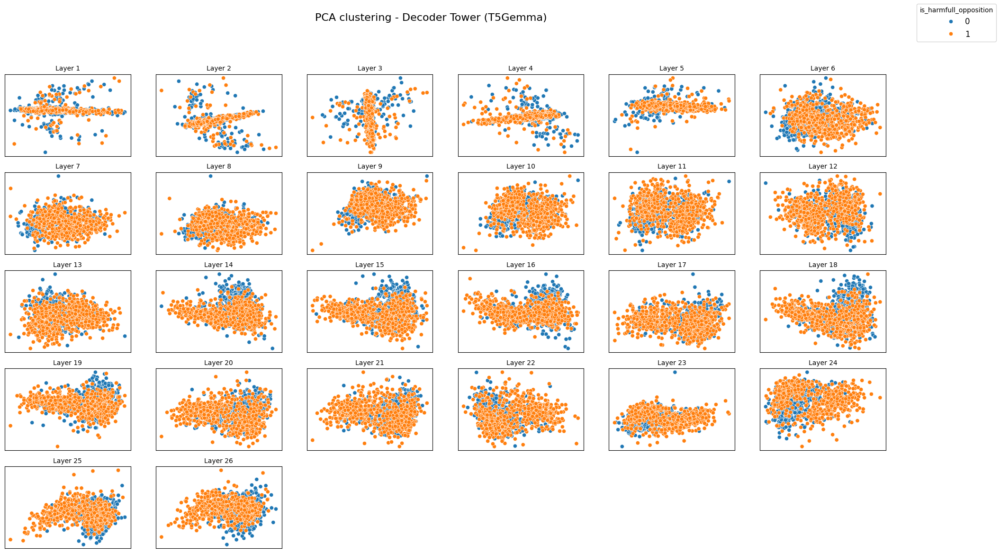

In [ ]:
# ──────────────────────────────────────────────────────────────────────────────
# 4‑B. Decoder tower  (last token works best)
# ──────────────────────────────────────────────────────────────────────────────
print("\n► Extracting *encoder* embeddings …")
X_pos_dec = embed_and_normalise(hate_total_yes_data['statement'],
                                tower_tag="dec_pos",
                                strategy="mean",
                                use_decoder=True,
                                model=model,
                                tokenizer=tokenizer)

X_neg_dec = embed_and_normalise(hate_total_no_data['statement'],
                                tower_tag="dec_neg",
                                strategy="mean",
                                use_decoder=True,
                                model=model,
                                tokenizer=tokenizer)

# CHANGED: Convert GPU tensors to CPU numpy arrays for plotting
X_pos_dec = X_pos_dec.cpu().numpy()
X_neg_dec = X_neg_dec.cpu().numpy()

print("\n► Plotting PCA for *encoder* embeddings …")
plot_pca_or_tsne_layerwise(X_pos_dec,
                           X_neg_dec,
                           hate_data['is_harmfull_opposition'],
                           standardize=False, n_components=5,
                           components=[0, 1], mode='pca',
                           plot_title='PCA clustering - Decoder Tower (T5Gemma)')


► Extracting *encoder* embeddings …


Extracting embeddings (strategy: last-token): 100%|██████████| 1250/1250 [19:20<00:00,  1.08it/s]


Extraction completed: shape=torch.Size([1250, 27, 2304]), dtype=torch.float32, device=cpu
Stats: max=128.000, min=-134.000, std=3.165


Extracting embeddings (strategy: last-token): 100%|██████████| 1250/1250 [20:46<00:00,  1.00it/s]


Extraction completed: shape=torch.Size([1250, 27, 2304]), dtype=torch.float32, device=cpu
Stats: max=79.000, min=-140.000, std=3.140

► Plotting PCA for *encoder* embeddings …


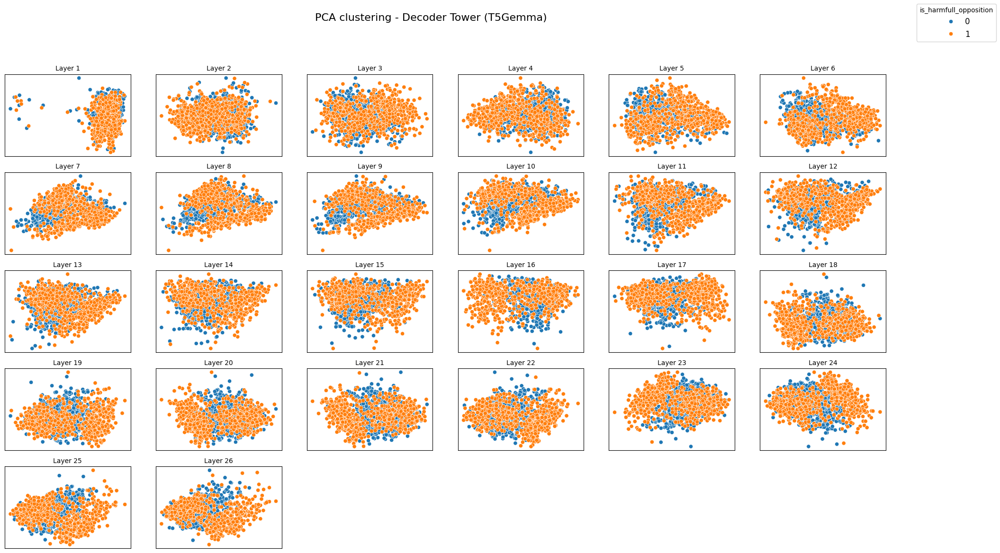

In [ ]:
# ──────────────────────────────────────────────────────────────────────────────
# 4‑B. Decoder tower  (last token works best)
# ──────────────────────────────────────────────────────────────────────────────
print("\n► Extracting *encoder* embeddings …")
X_pos_dec = embed_and_normalise(hate_total_yes_data['statement'],
                                tower_tag="dec_pos",
                                strategy="last-token",
                                use_decoder=True,
                                model=model,
                                tokenizer=tokenizer)

X_neg_dec = embed_and_normalise(hate_total_no_data['statement'],
                                tower_tag="dec_neg",
                                strategy="last-token",
                                use_decoder=True,
                                model=model,
                                tokenizer=tokenizer)

# CHANGED: Convert GPU tensors to CPU numpy arrays for plotting
X_pos_dec = X_pos_dec.cpu().numpy()
X_neg_dec = X_neg_dec.cpu().numpy()

print("\n► Plotting PCA for *encoder* embeddings …")
plot_pca_or_tsne_layerwise(X_pos_dec,
                           X_neg_dec,
                           hate_data['is_harmfull_opposition'],
                           standardize=False, n_components=5,
                           components=[0, 1], mode='pca',
                           plot_title='PCA clustering - Decoder Tower (T5Gemma)')

In [3]:
import sys
import os

# Add the code directory directly to Python path
code_dir = '/Users/elenaericheva/ericheva_git/ccs_aisf/code'
if code_dir not in sys.path:
    sys.path.insert(0, code_dir)

print(f"Added {code_dir} to Python path")
import random, numpy as np, torch, pickle, matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from ccs import train_ccs_on_hidden_states
import pandas as pd


SEED = 42
random.seed(SEED); np.random.seed(SEED); torch.manual_seed(SEED)
torch.backends.cudnn.deterministic, torch.backends.cudnn.benchmark = True, False

def run_ccs(X_pos_norm, X_neg_norm, *, tower_tag):
    # Train / test split once per tower
    idx              = np.arange(len(X_pos_norm))
    train_idx, test_idx = train_test_split(idx, test_size=0.2,
                                           random_state=71, shuffle=True)

    # CCS
    ccs_layers = train_ccs_on_hidden_states(X_pos_norm,
                                            X_neg_norm,
                                            hate_data['is_harmfull_opposition'],
                                            train_idx, test_idx,
                                            normalizing='median')

    # save
    with open(f'ccs_{YOUR_NAME}_{tower_tag}_ttt_results.pkl', 'wb') as f:
        pickle.dump(ccs_layers, f)

    # Accuracy curve
    acc = [layer_data['accuracy'] for layer_idx, layer_data in ccs_layers.items()]
    plt.figure(); plt.plot(acc); plt.title(f'CCS accuracy per layer ({tower_tag})')
    plt.xlabel('Layer'); plt.ylabel('Accuracy'); plt.show()

    # Best layer
    best_layer = int(np.argmax(acc))
    print(f'► Best {tower_tag} layer = {best_layer}  (acc={acc[best_layer]:.3f})')
    return best_layer

# best_enc_layer = run_ccs(X_pos_enc, X_neg_enc, tower_tag='enc')


Added /Users/elenaericheva/ericheva_git/ccs_aisf/code to Python path


Median normalize used
Layer 1/27, CCS accuracy: 0.516
Median normalize used
Layer 2/27, CCS accuracy: 0.52
Median normalize used
Layer 3/27, CCS accuracy: 0.524
Median normalize used
Layer 4/27, CCS accuracy: 0.504
Median normalize used
Layer 5/27, CCS accuracy: 0.516
Median normalize used
Layer 6/27, CCS accuracy: 0.5
Median normalize used
Layer 7/27, CCS accuracy: 0.512
Median normalize used
Layer 8/27, CCS accuracy: 0.524
Median normalize used
Layer 9/27, CCS accuracy: 0.52
Median normalize used
Layer 10/27, CCS accuracy: 0.528
Median normalize used
Layer 11/27, CCS accuracy: 0.516
Median normalize used
Layer 12/27, CCS accuracy: 0.5
Median normalize used
Layer 13/27, CCS accuracy: 0.512
Median normalize used
Layer 14/27, CCS accuracy: 0.504
Median normalize used
Layer 15/27, CCS accuracy: 0.504
Median normalize used
Layer 16/27, CCS accuracy: 0.52
Median normalize used
Layer 17/27, CCS accuracy: 0.544
Median normalize used
Layer 18/27, CCS accuracy: 0.528
Median normalize used
Laye

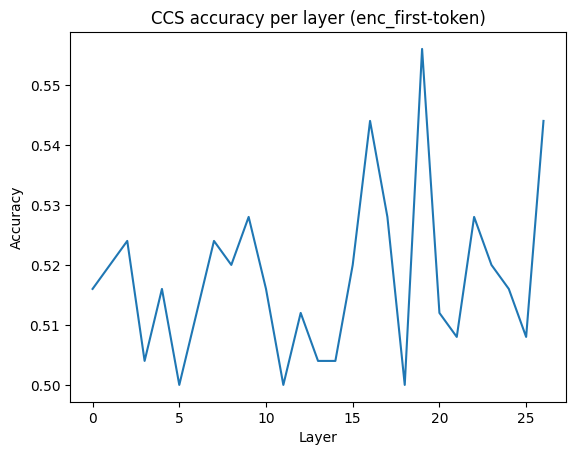

► Best enc_first-token layer = 19  (acc=0.556)


In [4]:
YOUR_NAME = "t5gemma-2b-2b-ul2-it"
strategy = "first-token"
hate_data = pd.read_csv('../data/raw/total_hate3.0.csv', index_col=0)
X_pos_enc = np.load(f"{YOUR_NAME}_enc_pos_{strategy}_ttt.npz")['arr_0']
X_neg_enc = np.load(f"{YOUR_NAME}_enc_neg_{strategy}_ttt.npz")['arr_0']
best_enc_layer = run_ccs(X_pos_enc, X_neg_enc, tower_tag=f'enc_{strategy}')

Median normalize used
Layer 1/27, CCS accuracy: 0.516
Median normalize used
Layer 2/27, CCS accuracy: 0.536
Median normalize used
Layer 3/27, CCS accuracy: 0.568
Median normalize used
Layer 4/27, CCS accuracy: 0.572
Median normalize used
Layer 5/27, CCS accuracy: 0.616
Median normalize used
Layer 6/27, CCS accuracy: 0.616
Median normalize used
Layer 7/27, CCS accuracy: 0.58
Median normalize used
Layer 8/27, CCS accuracy: 0.6
Median normalize used
Layer 9/27, CCS accuracy: 0.588
Median normalize used
Layer 10/27, CCS accuracy: 0.576
Median normalize used
Layer 11/27, CCS accuracy: 0.592
Median normalize used
Layer 12/27, CCS accuracy: 0.5760000000000001
Median normalize used
Layer 13/27, CCS accuracy: 0.596
Median normalize used
Layer 14/27, CCS accuracy: 0.6
Median normalize used
Layer 15/27, CCS accuracy: 0.592
Median normalize used
Layer 16/27, CCS accuracy: 0.644
Median normalize used
Layer 17/27, CCS accuracy: 0.644
Median normalize used
Layer 18/27, CCS accuracy: 0.64
Median norma

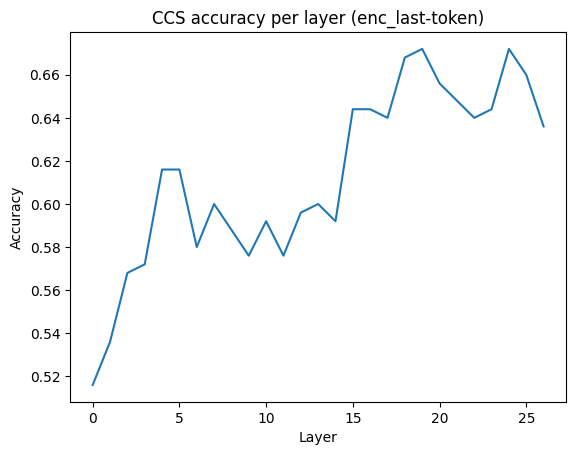

► Best enc_last-token layer = 19  (acc=0.672)


In [5]:
YOUR_NAME = "t5gemma-2b-2b-ul2-it"
strategy = "last-token"
hate_data = pd.read_csv('../data/raw/total_hate3.0.csv', index_col=0)
X_pos_enc = np.load(f"{YOUR_NAME}_enc_pos_{strategy}_ttt.npz")['arr_0']
X_neg_enc = np.load(f"{YOUR_NAME}_enc_neg_{strategy}_ttt.npz")['arr_0']
best_enc_layer = run_ccs(X_pos_enc, X_neg_enc, tower_tag=f'enc_{strategy}')

Median normalize used
Layer 1/27, CCS accuracy: 0.516
Median normalize used
Layer 2/27, CCS accuracy: 0.508
Median normalize used
Layer 3/27, CCS accuracy: 0.608
Median normalize used
Layer 4/27, CCS accuracy: 0.52
Median normalize used
Layer 5/27, CCS accuracy: 0.512
Median normalize used
Layer 6/27, CCS accuracy: 0.628
Median normalize used
Layer 7/27, CCS accuracy: 0.5920000000000001
Median normalize used
Layer 8/27, CCS accuracy: 0.5
Median normalize used
Layer 9/27, CCS accuracy: 0.648
Median normalize used
Layer 10/27, CCS accuracy: 0.512
Median normalize used
Layer 11/27, CCS accuracy: 0.628
Median normalize used
Layer 12/27, CCS accuracy: 0.648
Median normalize used
Layer 13/27, CCS accuracy: 0.52
Median normalize used
Layer 14/27, CCS accuracy: 0.508
Median normalize used
Layer 15/27, CCS accuracy: 0.52
Median normalize used
Layer 16/27, CCS accuracy: 0.504
Median normalize used
Layer 17/27, CCS accuracy: 0.644
Median normalize used
Layer 18/27, CCS accuracy: 0.504
Median norm

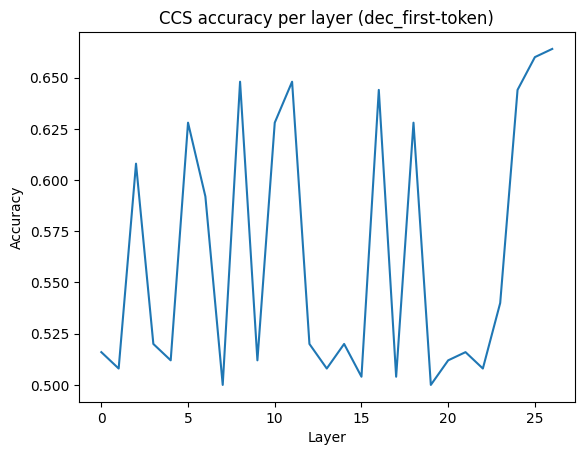

► Best dec_first-token layer = 26  (acc=0.664)


In [6]:
YOUR_NAME = "t5gemma-2b-2b-ul2-it"
strategy = "first-token"
hate_data = pd.read_csv('../data/raw/total_hate3.0.csv', index_col=0)
X_pos_dec = np.load(f"{YOUR_NAME}_dec_pos_{strategy}_ttt.npz")['arr_0']
X_neg_dec = np.load(f"{YOUR_NAME}_dec_neg_{strategy}_ttt.npz")['arr_0']
best_dec_layer = run_ccs(X_pos_dec, X_neg_dec, tower_tag=f'dec_{strategy}')

Median normalize used
Layer 1/27, CCS accuracy: 0.512
Median normalize used
Layer 2/27, CCS accuracy: 0.504
Median normalize used
Layer 3/27, CCS accuracy: 0.508
Median normalize used
Layer 4/27, CCS accuracy: 0.576
Median normalize used
Layer 5/27, CCS accuracy: 0.516
Median normalize used
Layer 6/27, CCS accuracy: 0.58
Median normalize used
Layer 7/27, CCS accuracy: 0.616
Median normalize used
Layer 8/27, CCS accuracy: 0.632
Median normalize used
Layer 9/27, CCS accuracy: 0.648
Median normalize used
Layer 10/27, CCS accuracy: 0.64
Median normalize used
Layer 11/27, CCS accuracy: 0.668
Median normalize used
Layer 12/27, CCS accuracy: 0.64
Median normalize used
Layer 13/27, CCS accuracy: 0.652
Median normalize used
Layer 14/27, CCS accuracy: 0.632
Median normalize used
Layer 15/27, CCS accuracy: 0.6799999999999999
Median normalize used
Layer 16/27, CCS accuracy: 0.656
Median normalize used
Layer 17/27, CCS accuracy: 0.652
Median normalize used
Layer 18/27, CCS accuracy: 0.652
Median no

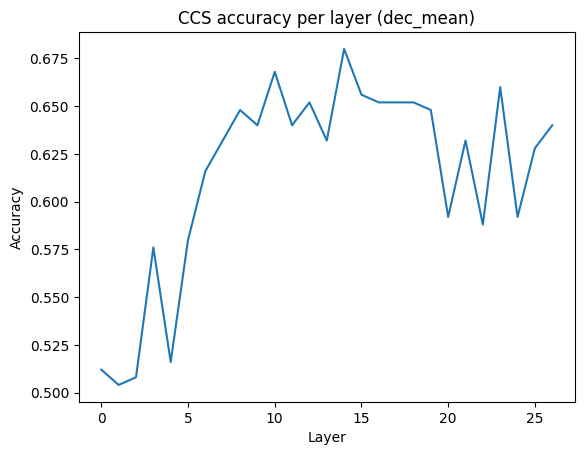

► Best dec_mean layer = 14  (acc=0.680)


In [7]:
YOUR_NAME = "t5gemma-2b-2b-ul2-it"
strategy = "mean"
hate_data = pd.read_csv('../data/raw/total_hate3.0.csv', index_col=0)
X_pos_dec = np.load(f"{YOUR_NAME}_dec_pos_{strategy}_ttt.npz")['arr_0']
X_neg_dec = np.load(f"{YOUR_NAME}_dec_neg_{strategy}_ttt.npz")['arr_0']
best_dec_layer = run_ccs(X_pos_dec, X_neg_dec, tower_tag=f'dec_{strategy}')

Median normalize used
Layer 1/27, CCS accuracy: 0.512
Median normalize used
Layer 2/27, CCS accuracy: 0.5
Median normalize used
Layer 3/27, CCS accuracy: 0.54
Median normalize used
Layer 4/27, CCS accuracy: 0.552
Median normalize used
Layer 5/27, CCS accuracy: 0.556
Median normalize used
Layer 6/27, CCS accuracy: 0.536
Median normalize used
Layer 7/27, CCS accuracy: 0.548
Median normalize used
Layer 8/27, CCS accuracy: 0.52
Median normalize used
Layer 9/27, CCS accuracy: 0.628
Median normalize used
Layer 10/27, CCS accuracy: 0.556
Median normalize used
Layer 11/27, CCS accuracy: 0.576
Median normalize used
Layer 12/27, CCS accuracy: 0.612
Median normalize used
Layer 13/27, CCS accuracy: 0.604
Median normalize used
Layer 14/27, CCS accuracy: 0.644
Median normalize used
Layer 15/27, CCS accuracy: 0.616
Median normalize used
Layer 16/27, CCS accuracy: 0.636
Median normalize used
Layer 17/27, CCS accuracy: 0.62
Median normalize used
Layer 18/27, CCS accuracy: 0.652
Median normalize used
La

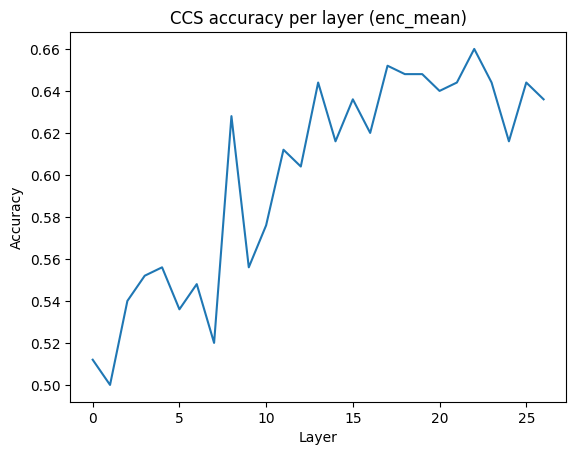

► Best enc_mean layer = 22  (acc=0.660)


In [8]:
# !!!!!!!!!
YOUR_NAME = "t5gemma-2b-2b-ul2-it"
strategy = "mean"
hate_data = pd.read_csv('../data/raw/total_hate3.0.csv', index_col=0)
X_pos_enc = np.load(f"{YOUR_NAME}_enc_pos_{strategy}_ttt.npz")['arr_0']
X_neg_enc = np.load(f"{YOUR_NAME}_enc_neg_{strategy}_ttt.npz")['arr_0']
best_enc_layer = run_ccs(X_pos_enc, X_neg_enc, tower_tag=f'enc_{strategy}')

Median normalize used
Layer 1/27, CCS accuracy: 0.516
Median normalize used
Layer 2/27, CCS accuracy: 0.5640000000000001
Median normalize used
Layer 3/27, CCS accuracy: 0.5680000000000001
Median normalize used
Layer 4/27, CCS accuracy: 0.5880000000000001
Median normalize used
Layer 5/27, CCS accuracy: 0.6
Median normalize used
Layer 6/27, CCS accuracy: 0.608
Median normalize used
Layer 7/27, CCS accuracy: 0.608
Median normalize used
Layer 8/27, CCS accuracy: 0.628
Median normalize used
Layer 9/27, CCS accuracy: 0.532
Median normalize used
Layer 10/27, CCS accuracy: 0.6599999999999999
Median normalize used
Layer 11/27, CCS accuracy: 0.54
Median normalize used
Layer 12/27, CCS accuracy: 0.536
Median normalize used
Layer 13/27, CCS accuracy: 0.6759999999999999
Median normalize used
Layer 14/27, CCS accuracy: 0.6639999999999999
Median normalize used
Layer 15/27, CCS accuracy: 0.544
Median normalize used
Layer 16/27, CCS accuracy: 0.6639999999999999
Median normalize used
Layer 17/27, CCS ac

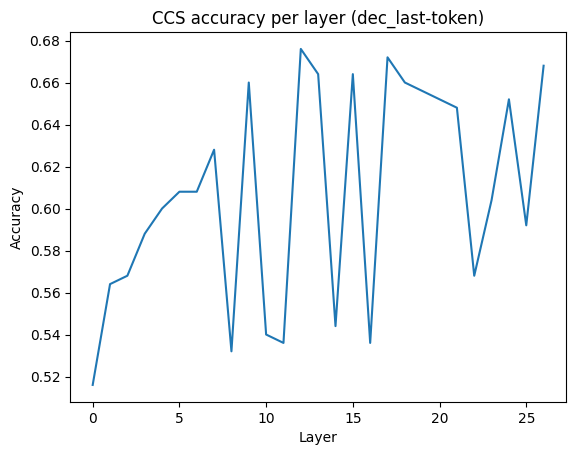

► Best dec_last-token layer = 12  (acc=0.676)


In [9]:
# !!!!!!!!!
YOUR_NAME = "t5gemma-2b-2b-ul2-it"
strategy = "last-token"
hate_data = pd.read_csv('../data/raw/total_hate3.0.csv', index_col=0)
X_pos_dec = np.load(f"{YOUR_NAME}_dec_pos_{strategy}_ttt.npz")['arr_0']
X_neg_dec = np.load(f"{YOUR_NAME}_dec_neg_{strategy}_ttt.npz")['arr_0']
best_dec_layer = run_ccs(X_pos_dec, X_neg_dec, tower_tag=f'dec_{strategy}')

In [10]:
1/0

ZeroDivisionError: division by zero

In [ ]:
from ccs import CCS
import pandas as pd, numpy as np, pickle
from sklearn.model_selection import train_test_split

def single_layer_ccs(X_pos_norm, X_neg_norm, best_layer, *, tower_tag):
    # Slice out the chosen layer
    X_pos_layer = pd.DataFrame(X_pos_norm[:, best_layer])
    X_neg_layer = pd.DataFrame(X_neg_norm[:, best_layer])

    idx = np.arange(len(X_pos_norm))
    train_idx, test_idx = train_test_split(idx, test_size=0.2,
                                           random_state=71, shuffle=True)

    # Train/test split
    X_pos_train = X_pos_layer.loc[train_idx].values.astype(np.float32)
    X_pos_test  = X_pos_layer.loc[test_idx].values.astype(np.float32)
    X_neg_train = X_neg_layer.loc[train_idx].values.astype(np.float32)
    X_neg_test  = X_neg_layer.loc[test_idx].values.astype(np.float32)

    y_train = hate_data['is_harmfull_opposition'][train_idx]
    y_test  = hate_data['is_harmfull_opposition'][test_idx]

    # Median normalise in‑place
    X_pos_train -= np.median(X_pos_train); X_pos_test -= np.median(X_pos_train)
    X_neg_train -= np.median(X_neg_train); X_neg_test -= np.median(X_neg_train)

    # CCS without labels (NEG first, then POS)
    ccs = CCS(X_neg_train, X_pos_train, y_train.values,
              var_normalize=False, lambda_classification=0,
              predict_normalize=False)
    ccs.repeated_train()

    acc = ccs.get_acc(X_neg_test, X_pos_test, y_test.values)
    print(f'CCS accuracy ({tower_tag}, layer {best_layer}) = {acc:.3f}')

    with open(f'ccs_{YOUR_NAME}_{tower_tag}_l{best_layer}.pkl', 'wb') as f:
        pickle.dump(ccs, f)

# Run for both towers
hate_data = pd.read_csv('../data/raw/total_hate3.0.csv.csv', index_col=0)
strategy = "mean"
X_pos_enc = np.load(f"{YOUR_NAME}_enc_pos_{strategy}_ttt.npz")['arr_0']
X_neg_enc = np.load(f"{YOUR_NAME}_enc_neg_{strategy}_ttt.npz")['arr_0']
single_layer_ccs(X_pos_enc, X_neg_enc, best_enc_layer, tower_tag=f'enc_{strategy}')
strategy = "first-token"
X_pos_enc = np.load(f"{YOUR_NAME}_enc_pos_{strategy}_ttt.npz")['arr_0']
X_neg_enc = np.load(f"{YOUR_NAME}_enc_neg_{strategy}_ttt.npz")['arr_0']
single_layer_ccs(X_pos_enc, X_neg_enc, best_enc_layer, tower_tag=f'enc_{strategy}')

best_enc_layer = 26
strategy = "last-token"
X_pos_enc = np.load(f"{YOUR_NAME}_enc_pos_{strategy}_ttt.npz")['arr_0']
X_neg_enc = np.load(f"{YOUR_NAME}_enc_neg_{strategy}_ttt.npz")['arr_0']
single_layer_ccs(X_pos_enc, X_neg_enc, best_enc_layer, tower_tag=f'enc_{strategy}!!!!')

print("")
strategy = "first-token"
X_pos_dec = np.load(f"{YOUR_NAME}_dec_pos_{strategy}_ttt.npz")['arr_0']
X_neg_dec = np.load(f"{YOUR_NAME}_dec_neg_{strategy}_ttt.npz")['arr_0']
single_layer_ccs(X_pos_dec, X_neg_dec, best_dec_layer, tower_tag=f'dec_{strategy}')
strategy = "mean"
X_pos_dec = np.load(f"{YOUR_NAME}_dec_pos_{strategy}_ttt.npz")['arr_0']
X_neg_dec = np.load(f"{YOUR_NAME}_dec_neg_{strategy}_ttt.npz")['arr_0']
single_layer_ccs(X_pos_dec, X_neg_dec, best_dec_layer, tower_tag=f'dec_{strategy}')

best_dec_layer = 26
strategy = "last-token"
X_pos_dec = np.load(f"{YOUR_NAME}_dec_pos_{strategy}_ttt.npz")['arr_0']
X_neg_dec = np.load(f"{YOUR_NAME}_dec_neg_{strategy}_ttt.npz")['arr_0']
single_layer_ccs(X_pos_dec, X_neg_dec, best_dec_layer, tower_tag=f'dec_{strategy}!!!!')


CCS accuracy (enc, layer 26) = 0.604
CCS accuracy (dec, layer 26) = 0.512


## **7. Plot results tables.**

In [ ]:
from format_results import get_results_table
orig_ccs_data = get_results_table(orig_ccs)

NameError: name 'orig_ccs' is not defined

In [ ]:
fig, ax = plt.subplots(figsize=(18, 5))

plt.plot(orig_ccs_data['accuracy'], label='Orig_CCS')

plt.hlines(1, 0, 7, label='ideal', colors='red', linewidth=3, linestyles=['--'])

plt.xlabel('Layer_number')
plt.ylabel('accuracy score ')
plt.legend(loc='upper right');

In [ ]:
from format_results import get_results_table
orig_ccs_data = get_results_table(orig_ccs)

fig, ax = plt.subplots(figsize=(18, 5))

plt.plot(orig_ccs_data['contradiction idx ↓'], label='Orig_CCS')

plt.hlines(0, 0, 7, label='ideal', colors='red', linewidth=3, linestyles=['--'])

plt.xlabel('Layer_number')
plt.ylabel('Contradiction idx score ')
plt.legend(loc='upper right');

In [ ]:
fig, ax = plt.subplots(figsize=(18, 5))

plt.plot(orig_ccs_data['agreement_score ↓'], label='Orig_CCS')

plt.hlines(0, 0, 7, label='ideal', colors='red', linewidth=3, linestyles=['--'])

plt.xlabel('Layer_number')
plt.ylabel('Agreement score ')
plt.legend(loc='upper right');